## **Import**

In [ ]:
from os import listdir
from os.path import isfile, join
import numpy as np
import cv2
import os
from tqdm import tqdm
import matplotlib.pyplot as plt

In [ ]:
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten,GlobalAveragePooling2D,BatchNormalization
from keras.layers import Conv2D, MaxPooling2D
import keras
from keras.models import Model

Switch to use GPU

In [ ]:
import tensorflow as tf
device_name = tf.test.gpu_device_name()
print(device_name)

/device:GPU:0


In [ ]:
from google.colab import files
files.upload() #upload kaggle.json

In [ ]:
!pip install -q kaggle
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!ls ~/.kaggle
!chmod 600 /root/.kaggle/kaggle.json

kaggle.json


## **Import dataset**

In [ ]:
!mkdir train
!mkdir test



*   train dateset



In [ ]:
!kaggle datasets download -d ayushv322/animal-classification

 99% 213M/215M [00:03<00:00, 93.4MB/s]
100% 215M/215M [00:03<00:00, 62.8MB/s]


In [ ]:
!unzip -q "/content/animal-classification.zip" -d "/content/train"



*   test dataset



In [ ]:
!gdown 1M7NBPEHZzPPK-hYtNEIvlwGd7GPjQ8fn

Downloading...
From: https://drive.google.com/uc?id=1M7NBPEHZzPPK-hYtNEIvlwGd7GPjQ8fn
To: /content/d_Test.zip
100% 19.9M/19.9M [00:00<00:00, 62.5MB/s]


In [ ]:
!unzip -q "/content/d_Test.zip" -d "/content/test/"



*   Load images





In [ ]:
width = 128
num_classes = 4
trainpath = '/content/train/'
testpath = '/content/test/'
trainImg = [trainpath+f for f in listdir(trainpath) if listdir(join(trainpath, f))]
testImg = [testpath+f for f in listdir(testpath) if listdir(join(testpath, f))]

In [ ]:
trainImg

['/content/train/Rhino',
 '/content/train/Elephant',
 '/content/train/Zebra',
 '/content/train/Buffalo']

In [ ]:
testImg

['/content/test/Rhino',
 '/content/test/Elephant',
 '/content/test/Zebra',
 '/content/test/Buffalo']

* tensorflow data loder

In [ ]:
def img2data(path):
  rawImgs = []
  labels = []
  c = 0
  
  for imagePath in (path):
      print(imagePath.split('/'))
      for item in tqdm(os.listdir(imagePath)):
          file = os.path.join(imagePath, item)
          #print(file)
          c+=1
          l = imagePath.split('/')[-1]
          
          if l == 'Buffalo':
            labels.append([1,0,0,0])         
          elif l == 'Elephant':
            labels.append([0,1,0,0])
          elif l == 'Rhino':
            labels.append([0,0,1,0])
          elif l == 'Zebra':
            labels.append([0,0,0,1])
          if file[-1] =='g':
            img = cv2.imread(file , cv2.COLOR_BGR2RGB)
            img = cv2.resize(img ,(width,width))
            rawImgs.append(img)
  return rawImgs, labels

In [ ]:
x_train, y_train = img2data(trainImg)
x_test, y_test = img2data(testImg)

['', 'content', 'train', 'Rhino']


100%|██████████| 1000/1000 [00:02<00:00, 475.10it/s]


['', 'content', 'train', 'Elephant']


100%|██████████| 1000/1000 [00:02<00:00, 463.94it/s]


['', 'content', 'train', 'Zebra']


100%|██████████| 1000/1000 [00:02<00:00, 462.64it/s]


['', 'content', 'train', 'Buffalo']


100%|██████████| 1000/1000 [00:01<00:00, 507.70it/s]


['', 'content', 'test', 'Rhino']


100%|██████████| 50/50 [00:00<00:00, 280.60it/s]


['', 'content', 'test', 'Elephant']


100%|██████████| 50/50 [00:00<00:00, 149.36it/s]


['', 'content', 'test', 'Zebra']


100%|██████████| 50/50 [00:00<00:00, 180.10it/s]


['', 'content', 'test', 'Buffalo']


100%|██████████| 50/50 [00:00<00:00, 80.16it/s]


In [ ]:
x_train = np.array(x_train)
y_train = np.array(y_train)
x_test = np.array(x_test)
y_test = np.array(y_test)
x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
x_train /= 255
x_test /= 255

In [ ]:
x_train.shape,y_train.shape,x_test.shape, y_test.shape

((4000, 128, 128, 3), (4000, 4), (200, 128, 128, 3), (200, 4))

## Model



*   Import model



In [ ]:
base_model = tf.keras.applications.ResNet50V2(
                                                                    weights='imagenet',
                                                                    include_top=False,
                                                                    input_shape=(width,width,3)
                                                                )

# base_model.trainable = False

for layer in base_model.layers[:175]:
    layer.trainable = False

In [ ]:
for i,later in enumerate(base_model.layers):
    print(i, layer.name,"-",layer.trainable)

0 conv5_block2_2_relu - False
1 conv5_block2_2_relu - False
2 conv5_block2_2_relu - False
3 conv5_block2_2_relu - False
4 conv5_block2_2_relu - False
5 conv5_block2_2_relu - False
6 conv5_block2_2_relu - False
7 conv5_block2_2_relu - False
8 conv5_block2_2_relu - False
9 conv5_block2_2_relu - False
10 conv5_block2_2_relu - False
11 conv5_block2_2_relu - False
12 conv5_block2_2_relu - False
13 conv5_block2_2_relu - False
14 conv5_block2_2_relu - False
15 conv5_block2_2_relu - False
16 conv5_block2_2_relu - False
17 conv5_block2_2_relu - False
18 conv5_block2_2_relu - False
19 conv5_block2_2_relu - False
20 conv5_block2_2_relu - False
21 conv5_block2_2_relu - False
22 conv5_block2_2_relu - False
23 conv5_block2_2_relu - False
24 conv5_block2_2_relu - False
25 conv5_block2_2_relu - False
26 conv5_block2_2_relu - False
27 conv5_block2_2_relu - False
28 conv5_block2_2_relu - False
29 conv5_block2_2_relu - False
30 conv5_block2_2_relu - False
31 conv5_block2_2_relu - False
32 conv5_block2_2_




*   Add layers







> แบบที่ 1



In [ ]:
transf_model = keras.Sequential([
    base_model,
    keras.layers.GlobalAveragePooling2D(),
    keras.layers.Flatten(),
    keras.layers.BatchNormalization(),
    keras.layers.Dense(256, activation='relu'),
    keras.layers.Dropout(0.2),
    keras.layers.BatchNormalization(),
    keras.layers.Dense(128, activation='relu'),
    keras.layers.Dropout(0.2),
    keras.layers.BatchNormalization(),
    keras.layers.Dense(64, activation='relu'),
    keras.layers.Dropout(0.2),
    keras.layers.BatchNormalization(),
    keras.layers.Dense(num_classes,activation='softmax')
])



> แบบที่ 2





In [ ]:
transf_model = keras.Sequential([
    base_model,
    keras.layers.GlobalAveragePooling2D(),
    keras.layers.Flatten(),
    keras.layers.Dense(512, activation='relu'),
    keras.layers.Dense(256, activation='relu'),
    keras.layers.Dense(128, activation='relu'),
    keras.layers.Dense(num_classes,activation='softmax')
])



> แบบที่ 3



In [ ]:
transf_model = keras.Sequential([
    base_model,
    keras.layers.Flatten(),
    keras.layers.Dense(512, activation='relu'),
    keras.layers.Dense(256, activation='relu'),
    keras.layers.Dense(128, activation='relu'),
    keras.layers.Dense(num_classes,activation='softmax')
])



> แบบที่ 4



In [ ]:
transf_model = keras.Sequential([
    base_model,
    keras.layers.Flatten(),
    keras.layers.Dense(512, activation='relu'),
    keras.layers.Dropout(0.2),
    keras.layers.Dense(256, activation='relu'),
    keras.layers.Dropout(0.2),
    keras.layers.Dense(128, activation='relu'),
    keras.layers.Dense(num_classes,activation='softmax')
])



> แบบที่ 5






In [ ]:
transf_model = keras.Sequential([
    base_model,
    keras.layers.Flatten(),
    keras.layers.BatchNormalization(),
    keras.layers.Dense(512, activation='relu'),
    keras.layers.Dropout(0.2),
    keras.layers.BatchNormalization(),
    keras.layers.Dense(256, activation='relu'),
    keras.layers.Dropout(0.2),
    keras.layers.BatchNormalization(),
    keras.layers.Dense(128, activation='relu'),
    keras.layers.Dropout(0.2),
    keras.layers.BatchNormalization(),
    keras.layers.Dense(num_classes,activation='softmax')
])

In [ ]:
transf_model.summary()

Model: "sequential_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50v2 (Functional)     (None, 4, 4, 2048)        23564800  
                                                                 
 flatten_20 (Flatten)        (None, 32768)             0         
                                                                 
 batch_normalization_28 (Bat  (None, 32768)            131072    
 chNormalization)                                                
                                                                 
 dense_101 (Dense)           (None, 512)               16777728  
                                                                 
 dropout_28 (Dropout)        (None, 512)               0         
                                                                 
 batch_normalization_29 (Bat  (None, 512)              2048      
 chNormalization)                                    



*   Compile & Train




In [ ]:
transf_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), loss='categorical_crossentropy' , metrics= ['accuracy'])

In [ ]:
batch_size = 32
epochs = 50

In [ ]:
history = transf_model.fit(x_train, y_train ,batch_size=batch_size, epochs=epochs ,validation_data=(x_test, y_test))

Epoch 1/50
125/125 [==============================] - 11s 56ms/step - loss: 0.5394 - accuracy: 0.7985 - val_loss: 0.1954 - val_accuracy: 0.9200
Epoch 2/50
125/125 [==============================] - 6s 49ms/step - loss: 0.1899 - accuracy: 0.9390 - val_loss: 0.1396 - val_accuracy: 0.9400
Epoch 3/50
125/125 [==============================] - 6s 48ms/step - loss: 0.1112 - accuracy: 0.9638 - val_loss: 0.1360 - val_accuracy: 0.9400
Epoch 4/50
125/125 [==============================] - 6s 48ms/step - loss: 0.0715 - accuracy: 0.9808 - val_loss: 0.1417 - val_accuracy: 0.9350
Epoch 5/50
125/125 [==============================] - 6s 48ms/step - loss: 0.0531 - accuracy: 0.9870 - val_loss: 0.1425 - val_accuracy: 0.9550
Epoch 6/50
125/125 [==============================] - 6s 48ms/step - loss: 0.0425 - accuracy: 0.9890 - val_loss: 0.0966 - val_accuracy: 0.9600
Epoch 7/50
125/125 [==============================] - 6s 50ms/step - loss: 0.0291 - accuracy: 0.9937 - val_loss: 0.1265 - val_accuracy: 0.955



*   Graph Accuracy & Loss



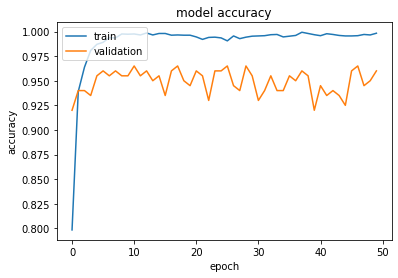

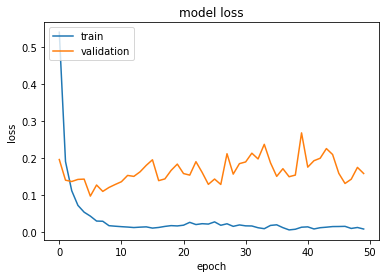

Train acc_max : 0.9992499947547913
Val acc_max : 0.9649999737739563
Train loss_min : 0.005182553548365831
Val loss_min : 0.09655512869358063


In [ ]:
import matplotlib.pyplot as plt
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()
# "Loss"
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()
print("Train acc_max :",max(history.history['accuracy']))
print("Val acc_max :",max(history.history['val_accuracy']))
print("Train loss_min :",min(history.history['loss']))
print("Val loss_min :",min(history.history['val_loss']))

## Test

1/1 [==============================] - 1s 829ms/step
[[1.2555690e-06 6.8771932e-04 9.9922824e-01 8.2786792e-05]]
real:images (5).jpg
predict:Rhino


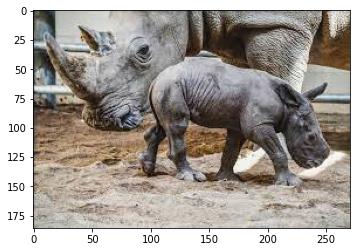

1/1 [==============================] - 0s 20ms/step
[[1.4426919e-08 1.2640743e-06 9.9999869e-01 1.8239898e-09]]
real:download (5).jpg
predict:Rhino


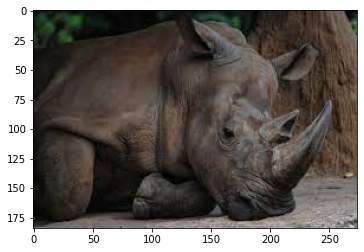

1/1 [==============================] - 0s 25ms/step
[[6.2862382e-05 1.4123244e-05 9.9974996e-01 1.7307371e-04]]
real:images (28).jpg
predict:Rhino


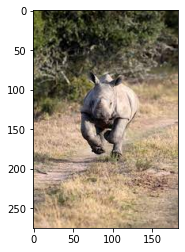

1/1 [==============================] - 0s 20ms/step
[[1.0251490e-02 2.7250421e-06 9.8974437e-01 1.3653807e-06]]
real:61107401_303.jpg
predict:Rhino


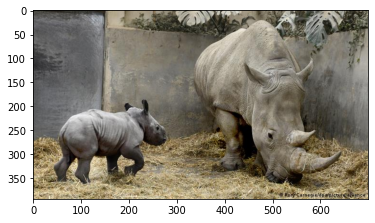

1/1 [==============================] - 0s 32ms/step
[[1.8002918e-05 5.9035118e-04 9.9934465e-01 4.6899750e-05]]
real:download (1).jpg
predict:Rhino


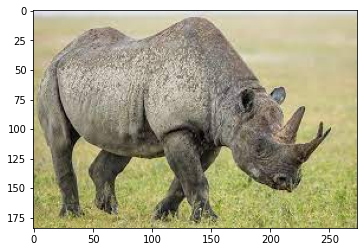

1/1 [==============================] - 0s 20ms/step
[[1.9586204e-09 1.5515973e-08 9.9999988e-01 9.4913339e-08]]
real:G0DL5oPyrtt5HBAi37PkeOBCk2tTKnkQY1wxDLrrnLV0XV1E4RHwTg.jpg
predict:Rhino


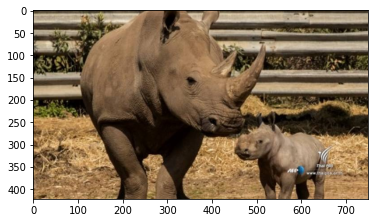

1/1 [==============================] - 0s 20ms/step
[[1.6819657e-04 6.7620617e-01 3.2260585e-01 1.0197432e-03]]
real:images (21).jpg
predict:Elephant


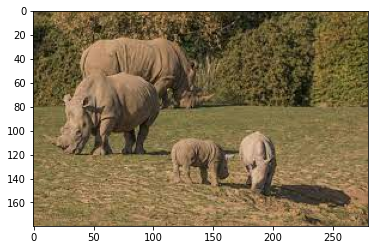

1/1 [==============================] - 0s 24ms/step
[[1.7145151e-06 1.1745985e-05 9.9998212e-01 4.3598016e-06]]
real:images (24).jpg
predict:Rhino


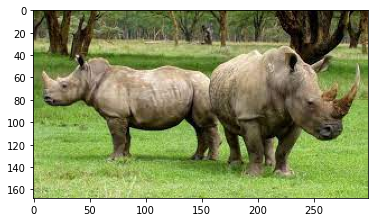

1/1 [==============================] - 0s 24ms/step
[[2.3452684e-04 4.8695500e-07 9.9976462e-01 3.7070038e-07]]
real:images (10).jpg
predict:Rhino


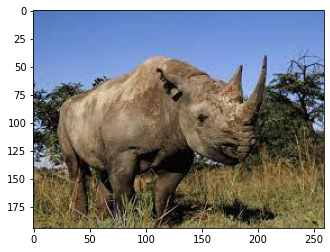

1/1 [==============================] - 0s 26ms/step
[[3.3820431e-06 7.2956404e-06 9.9998772e-01 1.6049783e-06]]
real:download (3).jpg
predict:Rhino


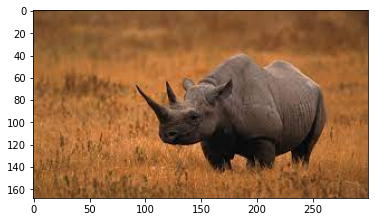

1/1 [==============================] - 0s 21ms/step
[[7.7464307e-08 2.5579613e-04 9.9974328e-01 8.4823387e-07]]
real:gi-rhinoceros-totem-56a46bf23df78cf772825b4b.jpg
predict:Rhino


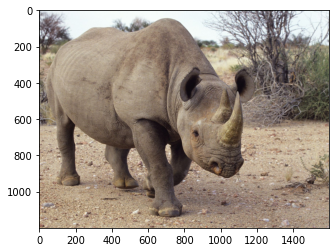

1/1 [==============================] - 0s 30ms/step
[[2.3617835e-03 4.4924283e-04 9.9710673e-01 8.2233491e-05]]
real:images.jpg
predict:Rhino


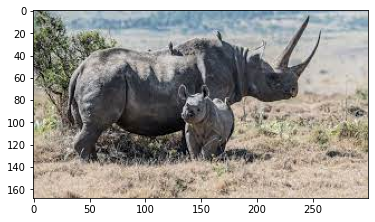

1/1 [==============================] - 0s 32ms/step
[[1.2289385e-09 4.2368046e-07 9.9999952e-01 1.5853409e-08]]
real:images (31).jpg
predict:Rhino


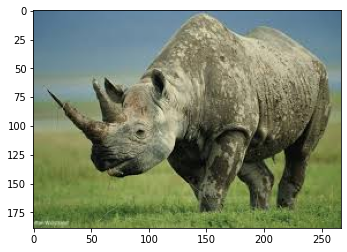

1/1 [==============================] - 0s 22ms/step
[[4.7504447e-05 1.1534715e-06 9.9993980e-01 1.1506014e-05]]
real:images (13).jpg
predict:Rhino


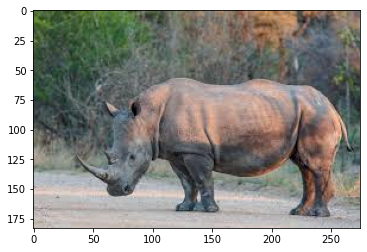

1/1 [==============================] - 0s 29ms/step
[[8.3134228e-09 4.8762065e-08 1.0000000e+00 5.9078449e-08]]
real:images (3).jpg
predict:Rhino


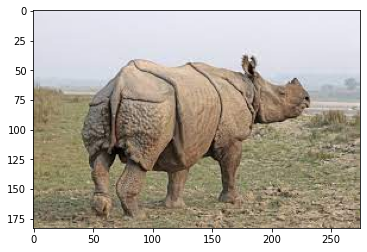

1/1 [==============================] - 0s 39ms/step
[[5.5243362e-07 1.6580920e-08 9.9999917e-01 1.8903573e-07]]
real:images (29).jpg
predict:Rhino


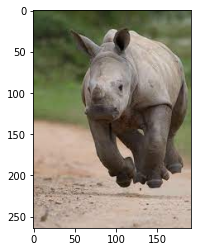

1/1 [==============================] - 0s 28ms/step
[[7.2946727e-01 1.5738004e-04 2.7028793e-01 8.7377419e-05]]
real:download.jpg
predict:Buffalo


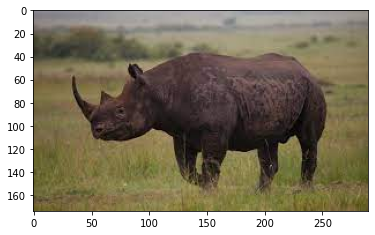

1/1 [==============================] - 0s 29ms/step
[[4.0725445e-06 5.2929760e-08 9.9999523e-01 6.2290803e-07]]
real:download (2).jpg
predict:Rhino


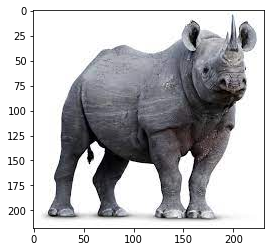

1/1 [==============================] - 0s 32ms/step
[[7.3239326e-06 1.2687459e-06 9.9999106e-01 3.9673728e-07]]
real:images (18).jpg
predict:Rhino


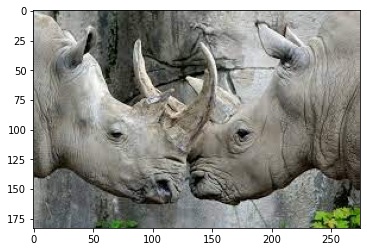

1/1 [==============================] - 0s 28ms/step
[[8.6164636e-07 1.5731724e-05 9.9998033e-01 3.1497314e-06]]
real:Sumatran_Rhino_2.jpg
predict:Rhino


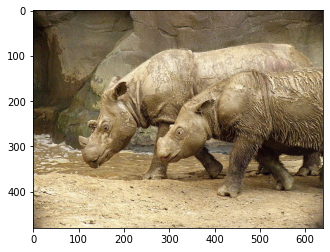

1/1 [==============================] - 0s 29ms/step
[[4.1740128e-05 2.6218739e-05 9.9993110e-01 9.6196811e-07]]
real:images (4).jpg
predict:Rhino


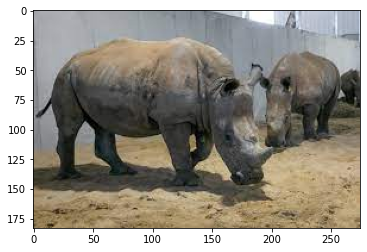

1/1 [==============================] - 0s 35ms/step
[[1.8458206e-05 2.2119766e-05 9.9995708e-01 2.3448899e-06]]
real:images (14).jpg
predict:Rhino


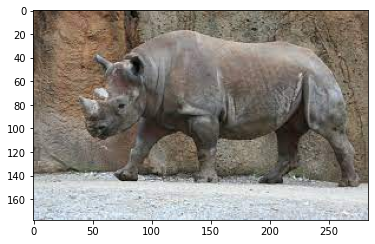

1/1 [==============================] - 0s 30ms/step
[[9.3352561e-09 2.9960907e-09 1.0000000e+00 1.3737788e-09]]
real:images (30).jpg
predict:Rhino


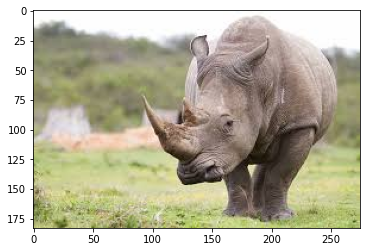

1/1 [==============================] - 0s 33ms/step
[[3.1868954e-09 1.1079617e-07 9.9999988e-01 3.7808402e-08]]
real:images (22).jpg
predict:Rhino


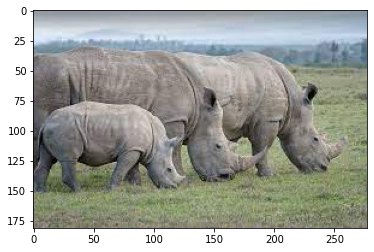

1/1 [==============================] - 0s 31ms/step
[[3.0283607e-05 2.6798117e-04 9.9963510e-01 6.6667824e-05]]
real:images (11).jpg
predict:Rhino


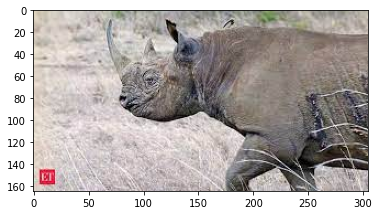

1/1 [==============================] - 0s 29ms/step
[[4.9370335e-04 7.1497732e-07 9.9950349e-01 2.0319035e-06]]
real:images (8).jpg
predict:Rhino


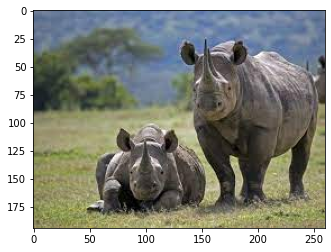

1/1 [==============================] - 0s 35ms/step
[[0.01194992 0.08383229 0.90298086 0.00123697]]
real:images (25).jpg
predict:Rhino


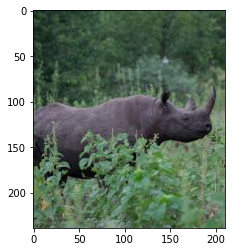

1/1 [==============================] - 0s 29ms/step
[[7.6256875e-08 5.2053277e-08 9.9999988e-01 1.2504538e-08]]
real:download (4).jpg
predict:Rhino


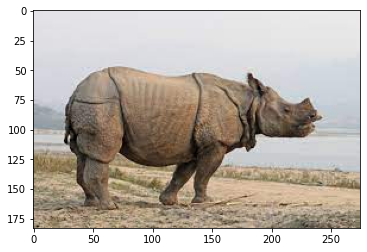

1/1 [==============================] - 0s 33ms/step
[[9.4478848e-05 3.9149987e-07 9.9990273e-01 2.4234073e-06]]
real:images (15).jpg
predict:Rhino


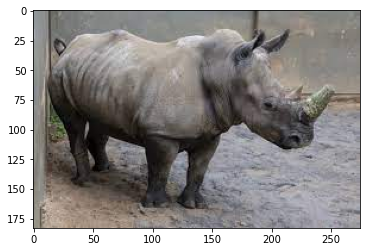

1/1 [==============================] - 0s 35ms/step
[[3.6962870e-06 3.6415483e-07 9.9999499e-01 9.4135515e-07]]
real:Rhinoceros-sinensis-2019-738x591.jpg
predict:Rhino


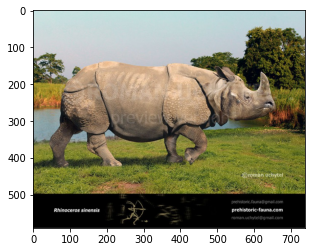

1/1 [==============================] - 0s 31ms/step
[[2.3257051e-05 1.1700670e-05 9.9995720e-01 7.8930216e-06]]
real:images (33).jpg
predict:Rhino


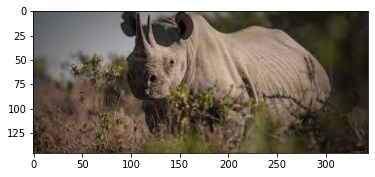

1/1 [==============================] - 0s 32ms/step
[[3.6258871e-06 3.8043680e-04 9.9960130e-01 1.4663767e-05]]
real:images (27).jpg
predict:Rhino


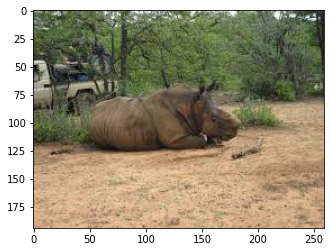

1/1 [==============================] - 0s 46ms/step
[[5.0342432e-04 3.0843532e-07 9.9949551e-01 7.4648790e-07]]
real:images (7).jpg
predict:Rhino


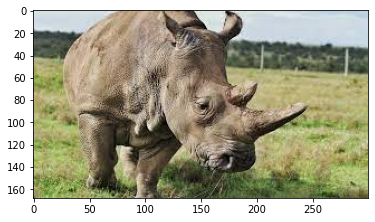

1/1 [==============================] - 0s 28ms/step
[[6.5521211e-03 1.3637384e-05 9.9341679e-01 1.7452498e-05]]
real:download (8).jpg
predict:Rhino


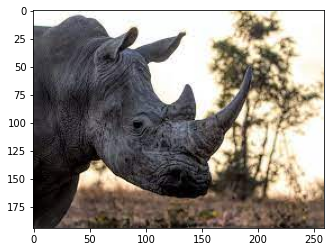

1/1 [==============================] - 0s 40ms/step
[[1.6163081e-05 9.4160714e-06 9.9997222e-01 2.1637206e-06]]
real:images (2).jpg
predict:Rhino


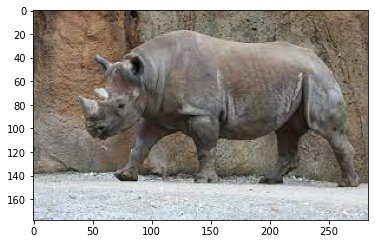

1/1 [==============================] - 0s 27ms/step
[[3.1642128e-07 1.0082226e-08 9.9999905e-01 5.5181857e-07]]
real:shutterstock_432544738.jpg
predict:Rhino


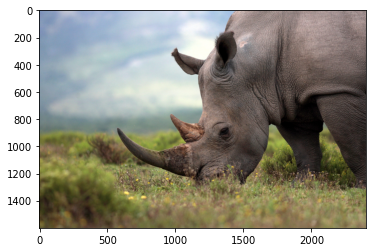

1/1 [==============================] - 0s 29ms/step
[[4.8501247e-06 1.9907711e-05 9.9997461e-01 6.1500094e-07]]
real:images (17).jpg
predict:Rhino


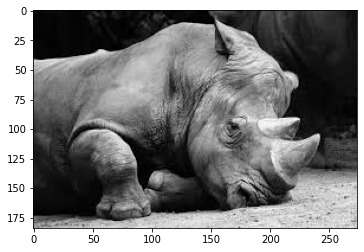

1/1 [==============================] - 0s 29ms/step
[[1.6494798e-03 6.6509484e-03 9.9168617e-01 1.3350315e-05]]
real:images (20).jpg
predict:Rhino


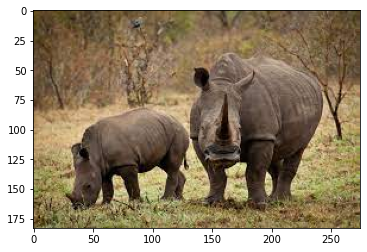

1/1 [==============================] - 0s 32ms/step
[[4.4050708e-02 8.4510988e-01 1.1035972e-01 4.7972836e-04]]
real:images (23).jpg
predict:Elephant


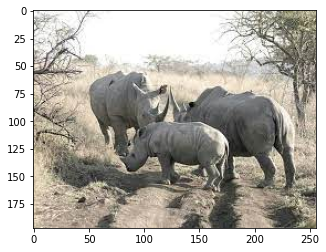

1/1 [==============================] - 0s 30ms/step
[[1.4013444e-08 4.3357279e-08 9.9998033e-01 1.9726509e-05]]
real:animals_hero_black_rhino_0.jpg
predict:Rhino


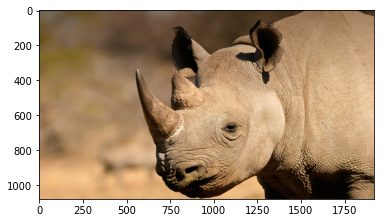

1/1 [==============================] - 0s 30ms/step
[[4.757281e-03 5.051599e-04 9.944912e-01 2.463312e-04]]
real:8018d022-59d5-4b71-b92d-0b6987c67279_cx0_cy7_cw0_w408_r1_s.jpg
predict:Rhino


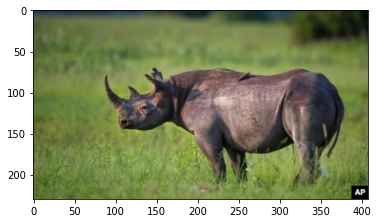

1/1 [==============================] - 0s 32ms/step
[[1.0494606e-02 3.4427479e-01 6.4516586e-01 6.4729509e-05]]
real:images (19).jpg
predict:Rhino


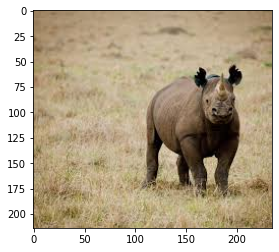

1/1 [==============================] - 0s 31ms/step
[[9.6941687e-07 1.4408855e-08 9.9999893e-01 1.3041242e-07]]
real:images (6).jpg
predict:Rhino


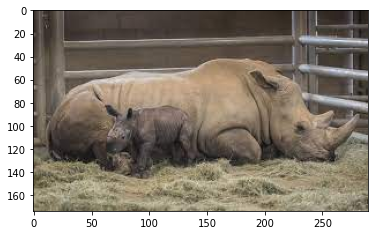

1/1 [==============================] - 0s 31ms/step
[[5.7908966e-07 6.2752736e-07 9.9999833e-01 4.7269822e-07]]
real:images (16).jpg
predict:Rhino


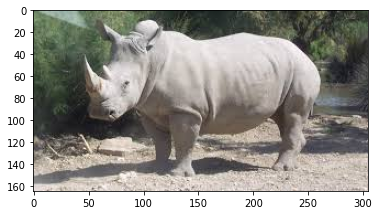

1/1 [==============================] - 0s 29ms/step
[[6.0313573e-04 4.0305104e-06 9.9939167e-01 1.1965566e-06]]
real:download (6).jpg
predict:Rhino


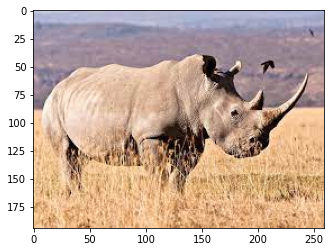

1/1 [==============================] - 0s 31ms/step
[[1.0793934e-06 9.2592677e-07 9.9998820e-01 9.8068722e-06]]
real:images (9).jpg
predict:Rhino


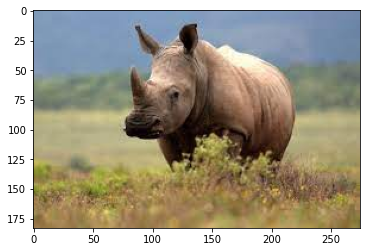

1/1 [==============================] - 0s 33ms/step
[[4.2047193e-07 1.7626917e-05 9.9998140e-01 6.2726781e-07]]
real:images (1).jpg
predict:Rhino


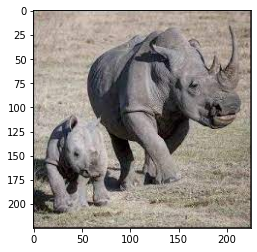

1/1 [==============================] - 0s 34ms/step
[[2.0278252e-08 2.7636702e-07 9.9999964e-01 9.5402100e-08]]
real:images (32).jpg
predict:Rhino


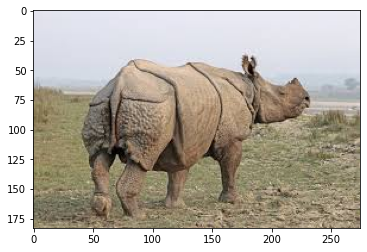

1/1 [==============================] - 0s 31ms/step
[[2.9959565e-02 1.2495104e-03 9.6863657e-01 1.5426303e-04]]
real:images (12).jpg
predict:Rhino


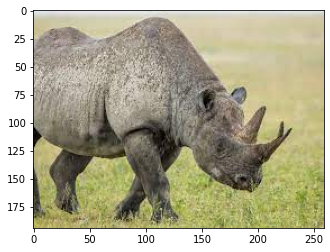

1/1 [==============================] - 0s 31ms/step
[[6.6240540e-07 1.5728023e-08 9.9999928e-01 1.5651354e-08]]
real:download (7).jpg
predict:Rhino


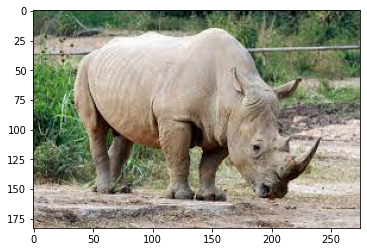

1/1 [==============================] - 0s 30ms/step
[[1.7851072e-03 9.9008769e-01 7.9973545e-03 1.2988268e-04]]
real:jamma_international-jamma_projects_elephants_alive_hands_on_feet-feat_img.jpg
predict:Elephant


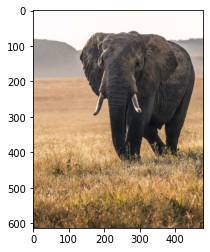

1/1 [==============================] - 0s 29ms/step
[[9.9772435e-01 1.9018754e-03 3.0623059e-04 6.7535024e-05]]
real:HD-wallpaper-indian-elephant-artwork-wildlife-elephas-maximus-indicus-elephants.jpg
predict:Buffalo


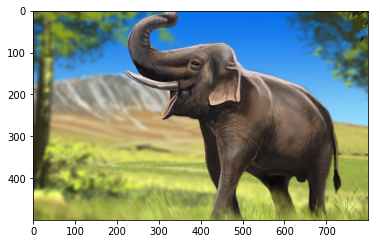

1/1 [==============================] - 0s 33ms/step
[[1.1612091e-06 9.9996495e-01 3.2033571e-05 1.8238877e-06]]
real:images (5).jpg
predict:Elephant


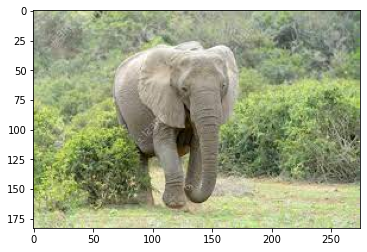

1/1 [==============================] - 0s 29ms/step
[[2.1401298e-04 9.9975067e-01 9.1968577e-06 2.6115244e-05]]
real:Elephant-1.jpg
predict:Elephant


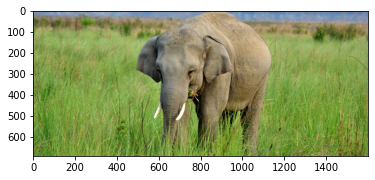

1/1 [==============================] - 0s 31ms/step
[[3.3601256e-05 9.9984658e-01 9.6420597e-05 2.3338058e-05]]
real:istockphoto-1134912915-612x612.jpg
predict:Elephant


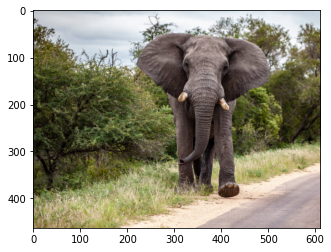

1/1 [==============================] - 0s 29ms/step
[[1.8543237e-06 9.9990642e-01 8.9620589e-05 2.0950110e-06]]
real:1_sSVTQaSTMti6ZcJRcsnSbA.jpeg
predict:Elephant


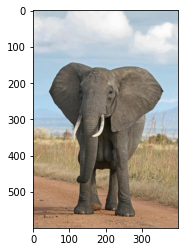

1/1 [==============================] - 0s 32ms/step
[[2.6638145e-05 3.7196044e-02 9.6267760e-01 9.9710363e-05]]
real:download (1).jpg
predict:Rhino


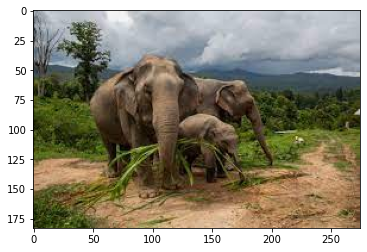

1/1 [==============================] - 0s 29ms/step
[[2.1983972e-09 1.0000000e+00 9.8821928e-09 2.1110067e-09]]
real:indian-elephant.jpg
predict:Elephant


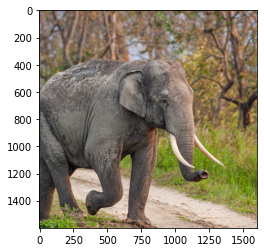

1/1 [==============================] - 0s 30ms/step
[[4.6911588e-05 9.9561149e-01 4.3380084e-03 3.6907404e-06]]
real:Website_SpeciesPage_ForestElephant03_01_Solutions.jpg
predict:Elephant


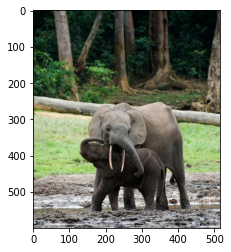

1/1 [==============================] - 0s 30ms/step
[[2.0526568e-06 9.9997985e-01 1.2050347e-05 6.1242226e-06]]
real:images (21).jpg
predict:Elephant


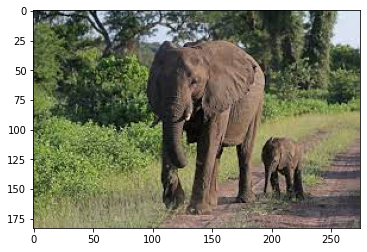

1/1 [==============================] - 0s 30ms/step
[[9.8439664e-01 1.2727739e-02 2.6607201e-03 2.1491110e-04]]
real:42477097_401.jpg
predict:Buffalo


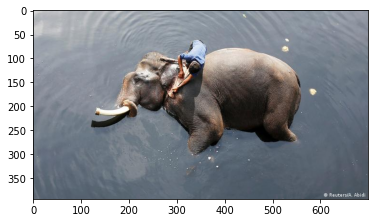

1/1 [==============================] - 0s 30ms/step
[[2.7056869e-05 9.9951458e-01 2.1587638e-04 2.4252245e-04]]
real:African_elephant_(Loxodonta_africana)_2.jpg
predict:Elephant


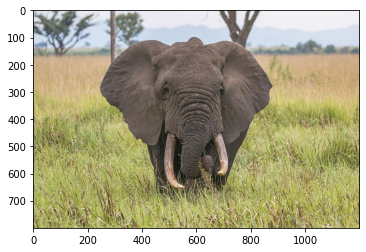

1/1 [==============================] - 0s 29ms/step
[[6.2535619e-06 9.9999380e-01 5.9077263e-09 5.2208570e-08]]
real:images (10).jpg
predict:Elephant


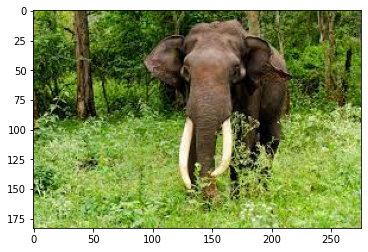

1/1 [==============================] - 0s 30ms/step
[[1.8116922e-05 9.9997878e-01 9.7635495e-07 2.0865646e-06]]
real:images.jpg
predict:Elephant


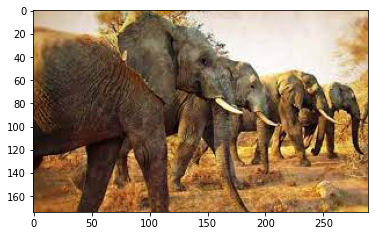

1/1 [==============================] - 0s 32ms/step
[[1.1185106e-05 9.9998188e-01 8.1740365e-07 6.1158648e-06]]
real:IndianElephant1.jpg
predict:Elephant


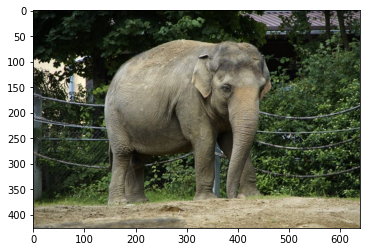

1/1 [==============================] - 0s 31ms/step
[[8.4384351e-07 9.9833280e-01 1.6617818e-03 4.6291912e-06]]
real:50068118993_6338c8b0f9_b.jpg
predict:Elephant


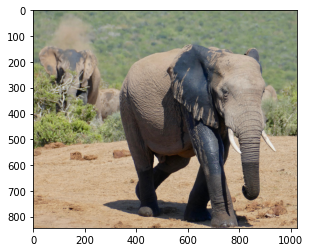

1/1 [==============================] - 0s 29ms/step
[[2.2471109e-07 9.9999368e-01 3.0894021e-06 3.0485996e-06]]
real:images (13).jpg
predict:Elephant


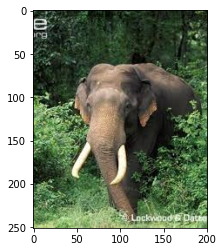

1/1 [==============================] - 0s 29ms/step
[[4.1937004e-03 9.9480587e-01 9.7607169e-04 2.4406958e-05]]
real:images (3).jpg
predict:Elephant


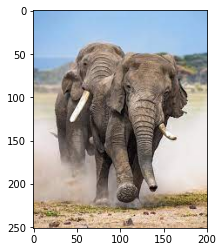

1/1 [==============================] - 0s 33ms/step
[[2.3598982e-06 9.9999034e-01 6.4996393e-06 8.1369751e-07]]
real:download.jpg
predict:Elephant


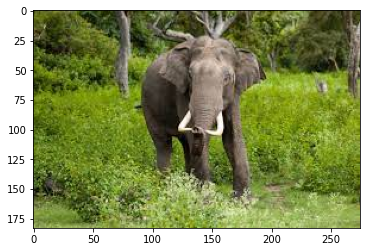

1/1 [==============================] - 0s 31ms/step
[[2.2271776e-07 9.9999940e-01 2.9619434e-07 1.0454591e-07]]
real:images (18).jpg
predict:Elephant


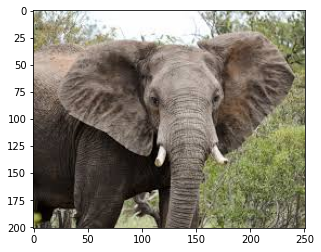

1/1 [==============================] - 0s 30ms/step
[[2.4459228e-05 9.9961346e-01 2.4847153e-05 3.3729503e-04]]
real:images (4).jpg
predict:Elephant


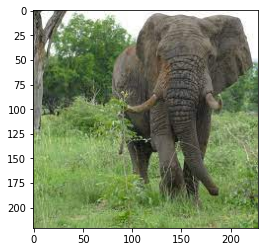

1/1 [==============================] - 0s 29ms/step
[[6.1390137e-06 9.9999285e-01 5.1632395e-07 5.0484545e-07]]
real:images (14).jpg
predict:Elephant


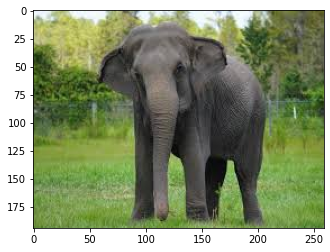

1/1 [==============================] - 0s 31ms/step
[[2.5909918e-07 9.9999976e-01 1.1724631e-08 3.2643079e-08]]
real:istockphoto-1322823772-170667a.jpg
predict:Elephant


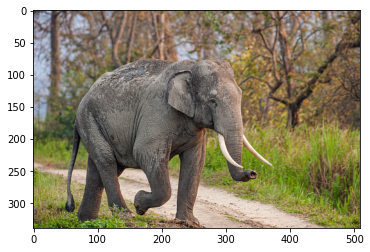

1/1 [==============================] - 0s 29ms/step
[[1.4041973e-05 9.9985266e-01 1.2576641e-04 7.5148373e-06]]
real:images (11).jpg
predict:Elephant


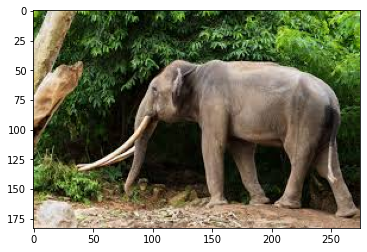

1/1 [==============================] - 0s 46ms/step
[[1.8646685e-06 9.9980396e-01 1.3596100e-04 5.8242953e-05]]
real:images (8).jpg
predict:Elephant


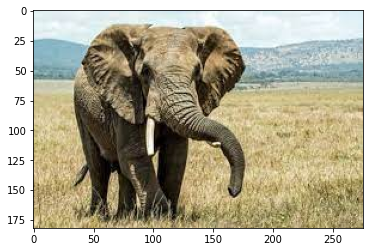

1/1 [==============================] - 0s 32ms/step
[[9.7654345e-05 9.7857964e-01 2.0990016e-02 3.3265245e-04]]
real:Elephant-thailand.jpg
predict:Elephant


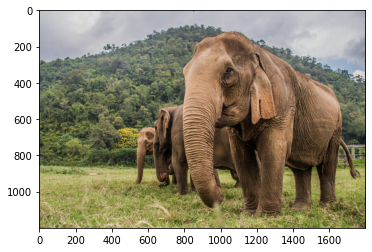

1/1 [==============================] - 0s 29ms/step
[[6.3725282e-05 9.9990797e-01 2.4694074e-05 3.5368257e-06]]
real:istockphoto-1335532293-612x612.jpg
predict:Elephant


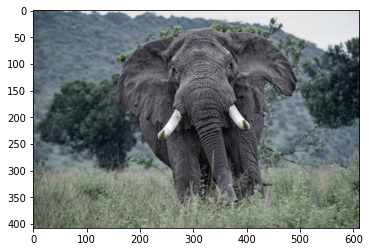

1/1 [==============================] - 0s 33ms/step
[[3.6257103e-07 9.9992394e-01 4.9032380e-05 2.6609243e-05]]
real:jamma_international-post-elephants_alive-content50-50_image_left.jpg
predict:Elephant


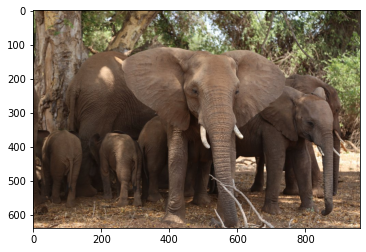

1/1 [==============================] - 0s 29ms/step
[[1.4741877e-06 9.9987698e-01 1.2012983e-04 1.4143203e-06]]
real:elephant.jpg
predict:Elephant


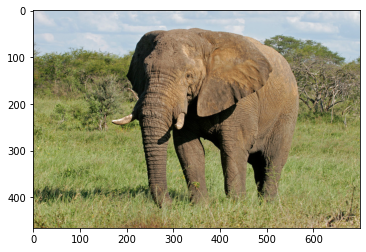

1/1 [==============================] - 0s 32ms/step
[[5.1294046e-04 9.9937987e-01 6.7272660e-05 3.9844203e-05]]
real:dataset-card.jpg
predict:Elephant


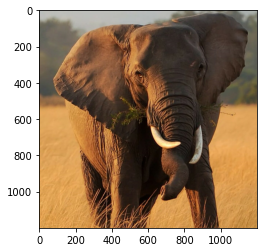

1/1 [==============================] - 0s 30ms/step
[[3.8814341e-07 9.9999940e-01 2.1497826e-08 1.5993396e-07]]
real:images (15).jpg
predict:Elephant


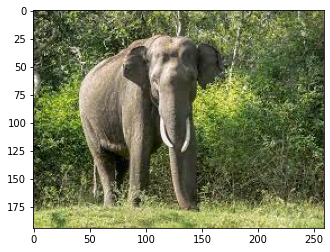

1/1 [==============================] - 0s 30ms/step
[[8.8180497e-04 7.4035376e-01 2.5869831e-01 6.6125060e-05]]
real:images (7).jpg
predict:Elephant


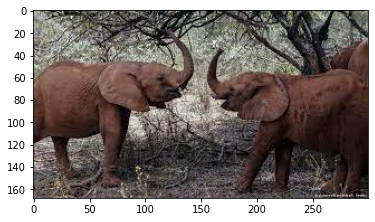

1/1 [==============================] - 0s 55ms/step
[[4.5869424e-09 1.0000000e+00 4.1642044e-11 3.0213967e-10]]
real:pict_large.jpg
predict:Elephant


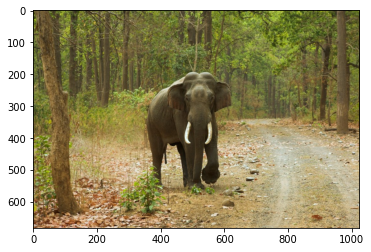

1/1 [==============================] - 0s 50ms/step
[[2.3394668e-06 9.9999058e-01 7.0162828e-06 5.6758552e-08]]
real:ExU8AJCXAAAy08V.jpg
predict:Elephant


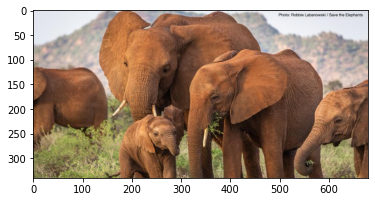

1/1 [==============================] - 0s 29ms/step
[[5.4429540e-05 9.9825233e-01 1.6926356e-03 6.3994605e-07]]
real:images (2).jpg
predict:Elephant


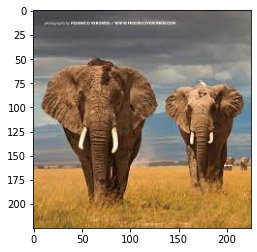

1/1 [==============================] - 0s 30ms/step
[[1.6744312e-05 9.9998271e-01 3.0704041e-07 3.0464838e-07]]
real:images (17).jpg
predict:Elephant


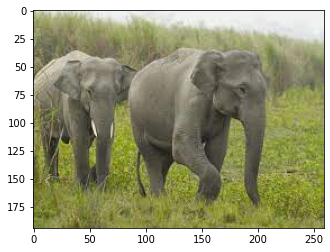

1/1 [==============================] - 0s 29ms/step
[[1.67735674e-08 9.99999881e-01 8.12110983e-08 1.42859164e-08]]
real:images (20).jpg
predict:Elephant


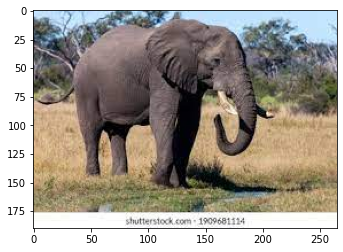

1/1 [==============================] - 0s 32ms/step
[[1.0116769e-05 9.9971944e-01 3.9349867e-05 2.3109453e-04]]
real:forest_elephant_l.jpg
predict:Elephant


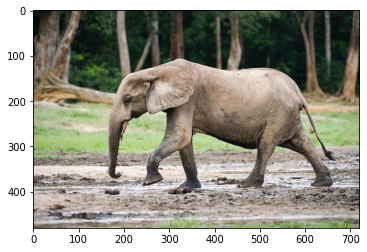

1/1 [==============================] - 0s 45ms/step
[[2.3859507e-01 7.5426173e-01 6.8185418e-03 3.2471033e-04]]
real:lllfdsrq5c8cxr4qt8ej.jpg
predict:Elephant


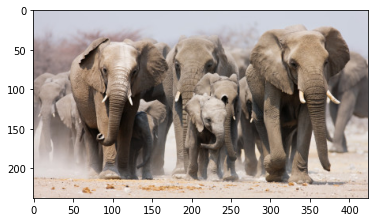

1/1 [==============================] - 0s 33ms/step
[[3.4436799e-04 9.9963856e-01 1.1088953e-05 5.9708987e-06]]
real:images (19).jpg
predict:Elephant


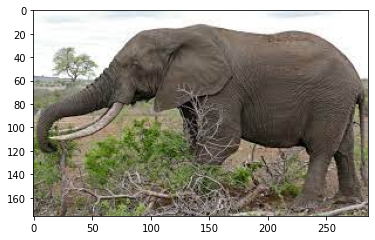

1/1 [==============================] - 0s 29ms/step
[[7.7103641e-06 9.9994874e-01 3.9195242e-05 4.3170285e-06]]
real:images (6).jpg
predict:Elephant


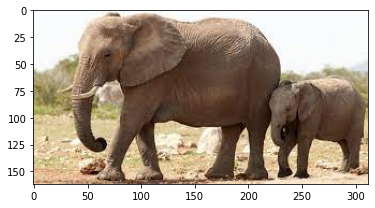

1/1 [==============================] - 0s 30ms/step
[[7.3526508e-07 9.9999785e-01 1.2728241e-06 2.0098921e-07]]
real:images (16).jpg
predict:Elephant


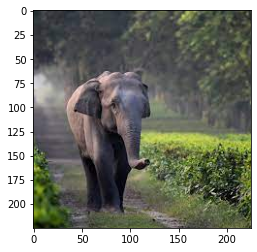

1/1 [==============================] - 0s 31ms/step
[[1.0174421e-04 9.9987304e-01 3.8614967e-06 2.1290005e-05]]
real:250px-AfricanElephant.jpg
predict:Elephant


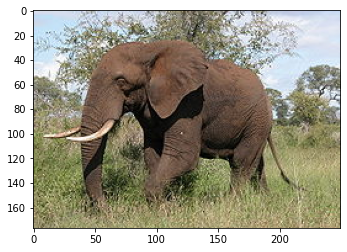

1/1 [==============================] - 0s 29ms/step
[[4.9832984e-08 9.9999022e-01 1.0323444e-06 8.6850287e-06]]
real:images (9).jpg
predict:Elephant


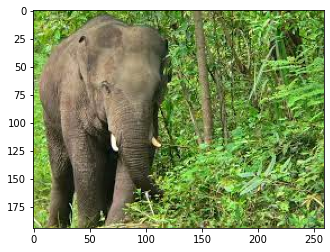

1/1 [==============================] - 0s 30ms/step
[[2.0241961e-05 9.9992931e-01 4.6609046e-05 3.8674893e-06]]
real:images (1).jpg
predict:Elephant


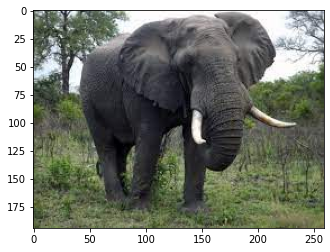

1/1 [==============================] - 0s 31ms/step
[[1.9484720e-07 9.9999964e-01 5.7335530e-08 5.8623481e-08]]
real:images (12).jpg
predict:Elephant


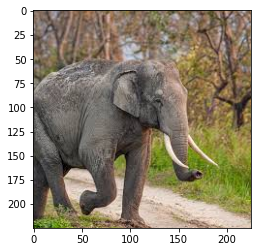

1/1 [==============================] - 0s 29ms/step
[[5.3949606e-07 9.9999642e-01 2.4001408e-06 5.4675428e-07]]
real:Bull_Indian_elephant.jpg
predict:Elephant


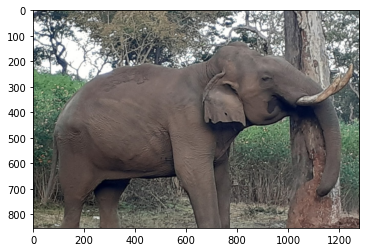

1/1 [==============================] - 0s 31ms/step
[[1.16645104e-07 9.99999642e-01 9.70054330e-08 1.64277893e-07]]
real:49138289047_4f418d6512_b.jpg
predict:Elephant


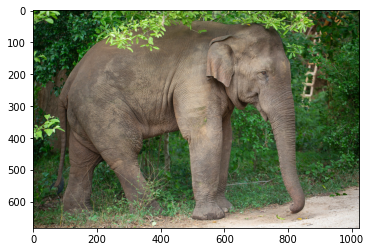

1/1 [==============================] - 0s 31ms/step
[[2.5640613e-05 9.9986255e-01 8.1894701e-05 2.9855830e-05]]
real:Matambu-elephant-bull-Elephants-Alive.jpg
predict:Elephant


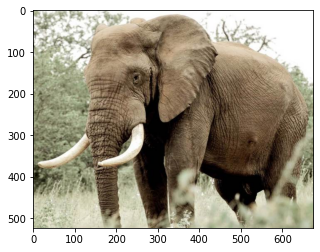

1/1 [==============================] - 0s 31ms/step
[[8.0690632e-04 9.9695337e-01 2.0645545e-03 1.7514470e-04]]
real:image1170x530cropped.jpg
predict:Elephant


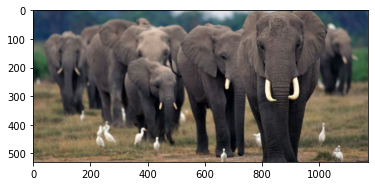

1/1 [==============================] - 0s 31ms/step
[[1.3242052e-06 1.1260055e-06 4.2442025e-08 9.9999750e-01]]
real:images (5).jpg
predict:Zebra


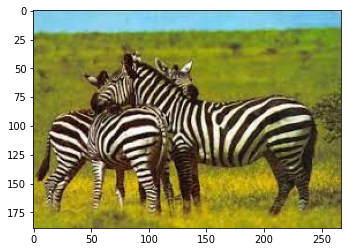

1/1 [==============================] - 0s 32ms/step
[[2.1859289e-06 1.1444457e-06 2.0988359e-08 9.9999666e-01]]
real:images (28).jpg
predict:Zebra


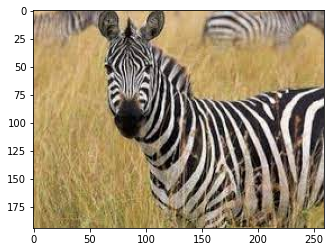

1/1 [==============================] - 0s 29ms/step
[[3.2640855e-05 1.7612695e-06 2.0661139e-06 9.9996352e-01]]
real:original.jpg
predict:Zebra


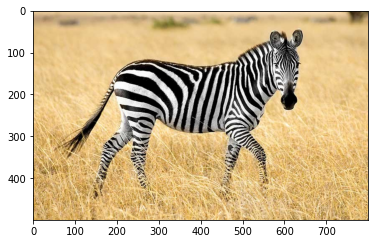

1/1 [==============================] - 0s 30ms/step
[[1.6469426e-01 8.5434640e-06 4.5784455e-04 8.3483928e-01]]
real:images (36).jpg
predict:Zebra


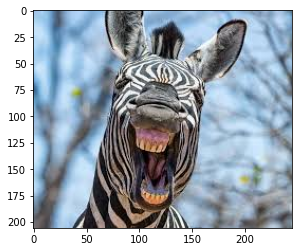

1/1 [==============================] - 0s 30ms/step
[[2.2546792e-06 9.1780691e-07 2.6265917e-08 9.9999678e-01]]
real:images (21).jpg
predict:Zebra


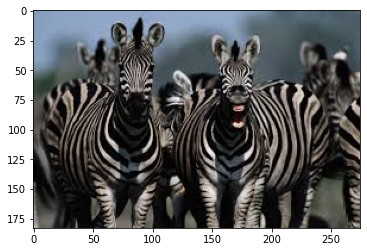

1/1 [==============================] - 0s 30ms/step
[[1.8142960e-05 2.1928479e-07 4.2630063e-08 9.9998164e-01]]
real:images (24).jpg
predict:Zebra


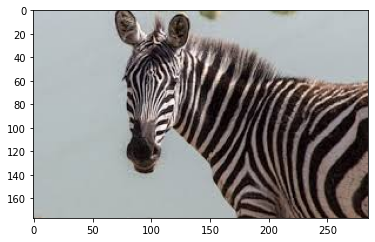

1/1 [==============================] - 0s 29ms/step
[[3.6598610e-06 2.7908020e-06 5.9641778e-08 9.9999344e-01]]
real:images (10).jpg
predict:Zebra


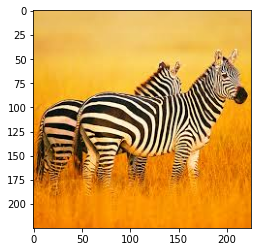

1/1 [==============================] - 0s 30ms/step
[[4.5699631e-05 2.7210133e-06 9.5910059e-07 9.9995065e-01]]
real:images.jpg
predict:Zebra


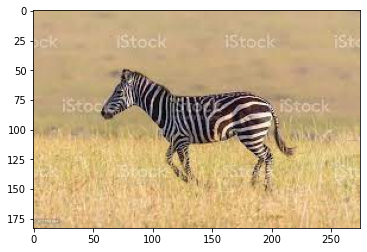

1/1 [==============================] - 0s 29ms/step
[[2.3722410e-04 5.2490914e-06 8.4008816e-06 9.9974912e-01]]
real:zebra-portrait-on-african-savanna-michal-bednarek.jpg
predict:Zebra


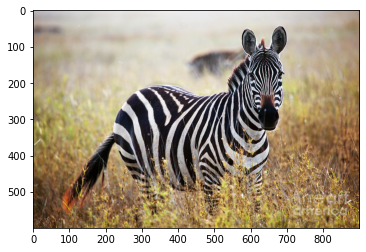

1/1 [==============================] - 0s 32ms/step
[[3.5331548e-05 8.5990325e-07 3.2573119e-08 9.9996376e-01]]
real:images (31).jpg
predict:Zebra


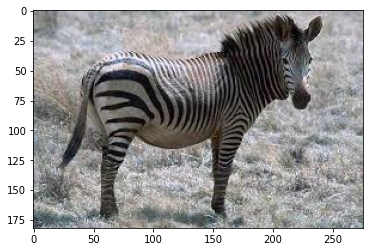

1/1 [==============================] - 0s 29ms/step
[[1.1996162e-06 2.8493075e-06 5.5753540e-06 9.9999034e-01]]
real:images (13).jpg
predict:Zebra


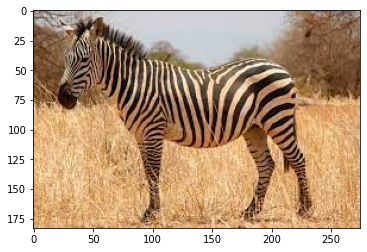

1/1 [==============================] - 0s 30ms/step
[[5.1912679e-08 1.8140675e-07 2.9582490e-09 9.9999976e-01]]
real:images (3).jpg
predict:Zebra


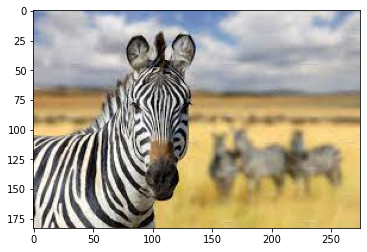

1/1 [==============================] - 0s 29ms/step
[[2.4044662e-05 2.0689331e-06 5.4603451e-08 9.9997389e-01]]
real:hero_zebra_animals.jpg
predict:Zebra


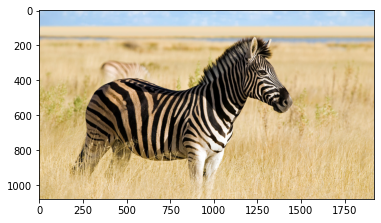

1/1 [==============================] - 0s 31ms/step
[[5.1902812e-06 8.9902279e-04 2.2924914e-05 9.9907291e-01]]
real:images (29).jpg
predict:Zebra


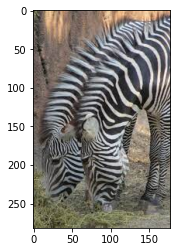

1/1 [==============================] - 0s 29ms/step
[[1.3275092e-04 2.7140497e-06 4.6342112e-07 9.9986398e-01]]
real:download.jpg
predict:Zebra


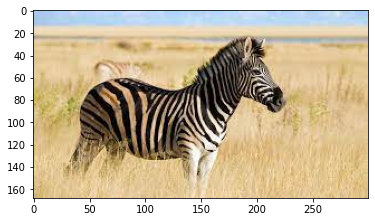

1/1 [==============================] - 0s 30ms/step
[[1.0256313e-06 2.7118966e-07 7.9505810e-07 9.9999785e-01]]
real:images (18).jpg
predict:Zebra


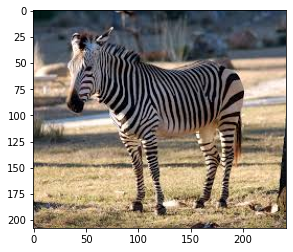

1/1 [==============================] - 0s 30ms/step
[[1.1198529e-06 6.8883364e-06 1.2659824e-06 9.9999070e-01]]
real:images (4).jpg
predict:Zebra


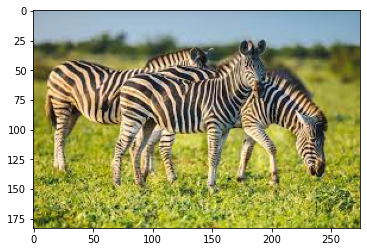

1/1 [==============================] - 0s 34ms/step
[[9.7756681e-04 2.3590195e-05 7.1239748e-07 9.9899811e-01]]
real:Zebra-on-the-African-savannah-Stock-Photo.jpg
predict:Zebra


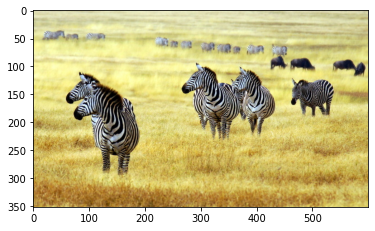

1/1 [==============================] - 0s 32ms/step
[[1.3715581e-05 1.5041721e-06 3.1548018e-07 9.9998438e-01]]
real:images (14).jpg
predict:Zebra


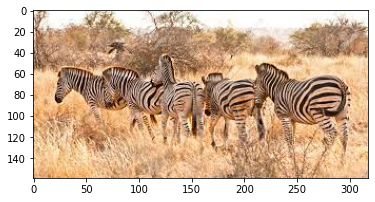

1/1 [==============================] - 0s 31ms/step
[[8.9481813e-07 2.2138513e-08 8.3752184e-08 9.9999893e-01]]
real:images (30).jpg
predict:Zebra


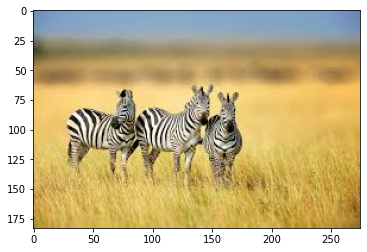

1/1 [==============================] - 0s 30ms/step
[[5.3078924e-07 5.8589375e-08 3.3590721e-09 9.9999940e-01]]
real:images (35).jpg
predict:Zebra


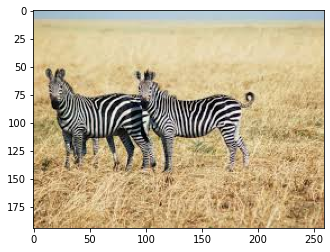

1/1 [==============================] - 0s 31ms/step
[[5.3668350e-07 6.7754115e-07 1.2838397e-06 9.9999750e-01]]
real:images (22).jpg
predict:Zebra


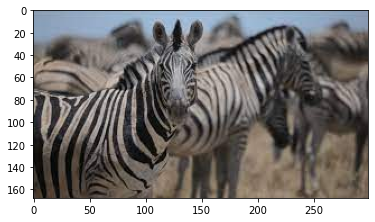

1/1 [==============================] - 0s 30ms/step
[[1.1313000e-05 2.3118211e-07 1.2295051e-07 9.9998832e-01]]
real:images (26).jpg
predict:Zebra


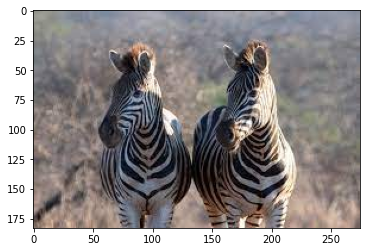

1/1 [==============================] - 0s 31ms/step
[[1.8648970e-07 1.3991678e-06 4.0623519e-08 9.9999845e-01]]
real:GettyImages-520064858-79cc024.jpg
predict:Zebra


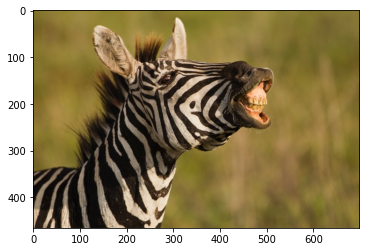

1/1 [==============================] - 0s 30ms/step
[[3.6632637e-06 3.2455169e-05 1.6809890e-05 9.9994707e-01]]
real:images (11).jpg
predict:Zebra


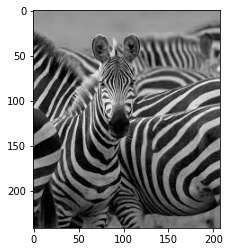

1/1 [==============================] - 0s 29ms/step
[[1.9821327e-05 8.0461012e-07 8.6096554e-07 9.9997854e-01]]
real:images (8).jpg
predict:Zebra


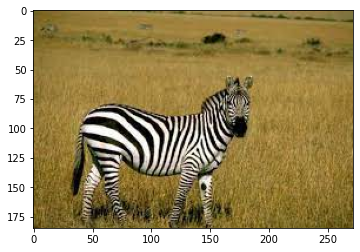

1/1 [==============================] - 0s 37ms/step
[[2.6947571e-06 7.9428034e-08 9.6107009e-08 9.9999714e-01]]
real:images (25).jpg
predict:Zebra


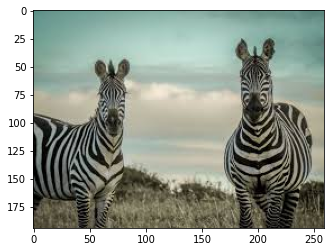

1/1 [==============================] - 0s 36ms/step
[[7.7148921e-10 2.3264995e-10 3.2252011e-12 1.0000000e+00]]
real:images (34).jpg
predict:Zebra


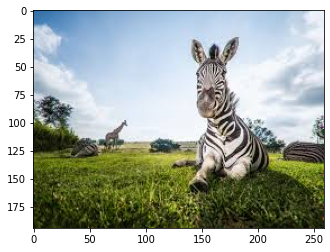

1/1 [==============================] - 0s 33ms/step
[[6.7119418e-06 3.0935103e-06 2.0350011e-08 9.9999022e-01]]
real:Hartmann_zebra_hobatere_S.jpg
predict:Zebra


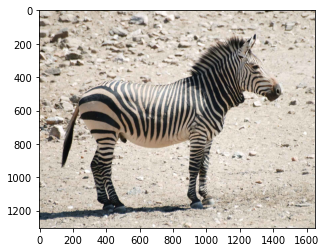

1/1 [==============================] - 0s 32ms/step
[[1.2840629e-06 1.4589267e-07 5.7205204e-07 9.9999797e-01]]
real:Zebra2-939b212484e1f17c03b24c7c307b0619.jpg
predict:Zebra


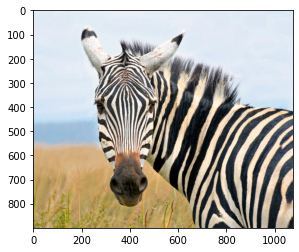

1/1 [==============================] - 0s 30ms/step
[[1.2321426e-07 6.1357586e-09 1.0536829e-08 9.9999988e-01]]
real:Common_zebra_1.jpg
predict:Zebra


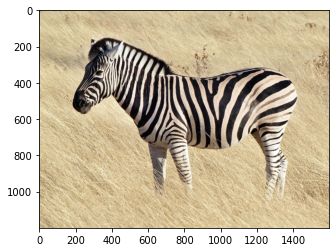

1/1 [==============================] - 0s 30ms/step
[[4.6993969e-06 2.5696543e-05 3.3020999e-06 9.9996626e-01]]
real:Equus_quagga.jpg
predict:Zebra


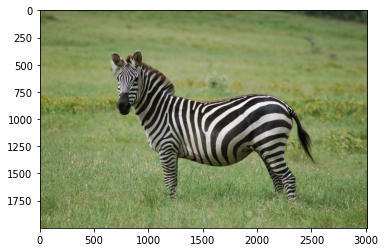

1/1 [==============================] - 0s 30ms/step
[[7.8749258e-07 6.1917525e-08 7.4316894e-08 9.9999905e-01]]
real:images (15).jpg
predict:Zebra


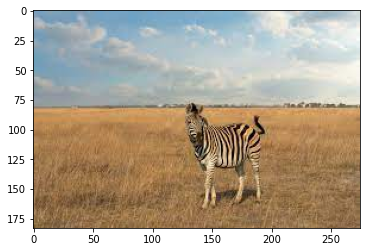

1/1 [==============================] - 0s 32ms/step
[[9.6808308e-06 7.7694574e-07 3.6735545e-07 9.9998915e-01]]
real:HjFE8NKWuCmgfHCcndJ3rK-320-80.jpg
predict:Zebra


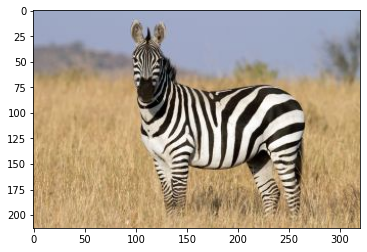

1/1 [==============================] - 0s 36ms/step
[[6.61270542e-06 1.05394754e-07 2.25544184e-07 9.99993086e-01]]
real:images (33).jpg
predict:Zebra


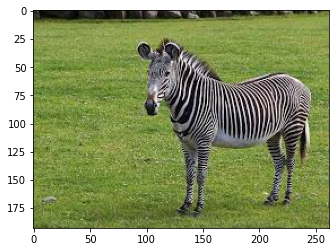

1/1 [==============================] - 0s 30ms/step
[[1.8867023e-07 4.2061338e-08 1.4266690e-08 9.9999976e-01]]
real:images (27).jpg
predict:Zebra


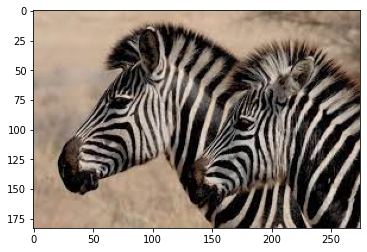

1/1 [==============================] - 0s 30ms/step
[[2.1400178e-06 2.3867408e-06 1.5202637e-06 9.9999392e-01]]
real:DSC_0473.jpg
predict:Zebra


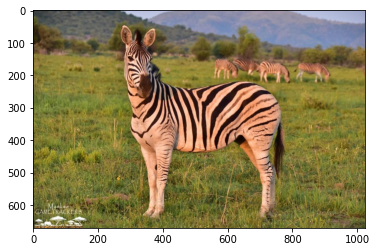

1/1 [==============================] - 0s 31ms/step
[[1.2341960e-06 3.5573436e-07 1.7731053e-09 9.9999845e-01]]
real:images (7).jpg
predict:Zebra


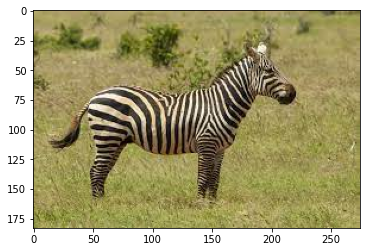

1/1 [==============================] - 0s 31ms/step
[[1.0859439e-03 1.6266260e-06 1.2615377e-05 9.9889982e-01]]
real:images (2).jpg
predict:Zebra


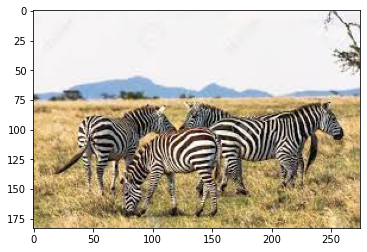

1/1 [==============================] - 0s 46ms/step
[[6.1117142e-05 4.1940712e-07 1.7541249e-06 9.9993670e-01]]
real:images (17).jpg
predict:Zebra


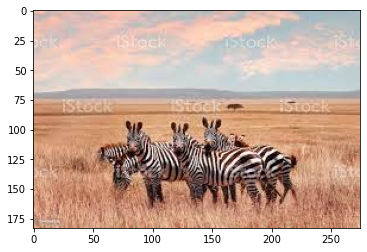

1/1 [==============================] - 0s 37ms/step
[[6.4121769e-10 1.9438344e-09 5.6773752e-10 1.0000000e+00]]
real:images (20).jpg
predict:Zebra


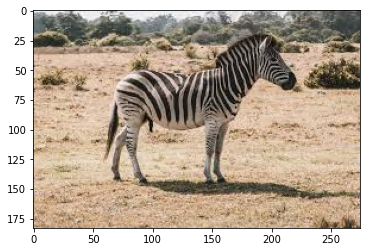

1/1 [==============================] - 0s 31ms/step
[[1.9691333e-05 4.0906346e-07 5.0710343e-09 9.9997985e-01]]
real:images (23).jpg
predict:Zebra


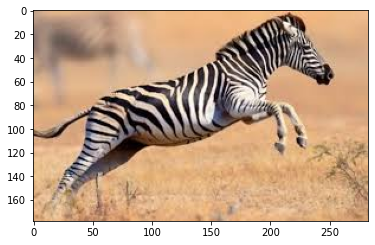

1/1 [==============================] - 0s 38ms/step
[[2.1184890e-06 1.1612171e-06 4.7593556e-08 9.9999666e-01]]
real:images (19).jpg
predict:Zebra


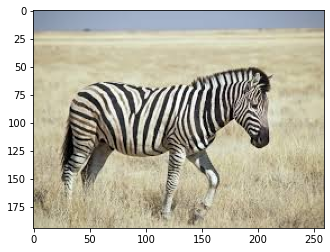

1/1 [==============================] - 0s 32ms/step
[[1.4041683e-07 2.2505054e-08 7.8747320e-08 9.9999976e-01]]
real:images (6).jpg
predict:Zebra


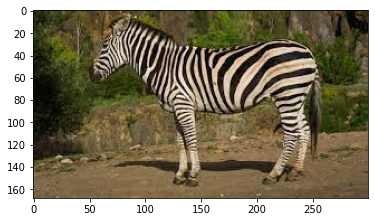

1/1 [==============================] - 0s 33ms/step
[[1.8142766e-04 9.9738757e-04 2.3273414e-03 9.9649388e-01]]
real:images (16).jpg
predict:Zebra


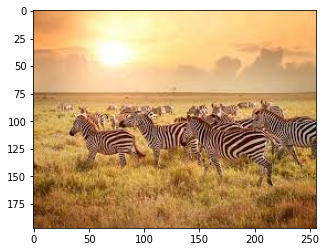

1/1 [==============================] - 0s 30ms/step
[[2.3924633e-07 4.9639550e-07 9.8872050e-08 9.9999917e-01]]
real:images (9).jpg
predict:Zebra


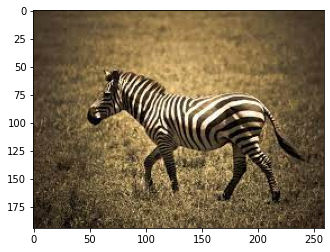

1/1 [==============================] - 0s 30ms/step
[[4.7584176e-06 4.2052099e-07 3.5656992e-06 9.9999130e-01]]
real:images (1).jpg
predict:Zebra


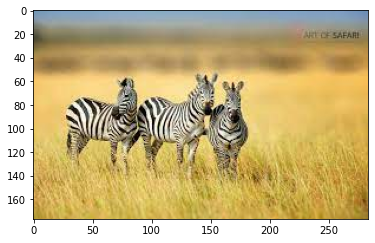

1/1 [==============================] - 0s 30ms/step
[[2.2602142e-05 4.0864415e-06 8.5831425e-06 9.9996471e-01]]
real:images (32).jpg
predict:Zebra


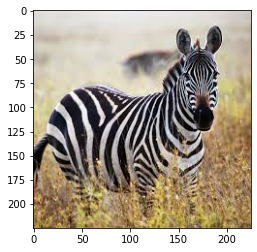

1/1 [==============================] - 0s 31ms/step
[[2.2301451e-07 8.1725675e-09 8.1748325e-08 9.9999964e-01]]
real:images (12).jpg
predict:Zebra


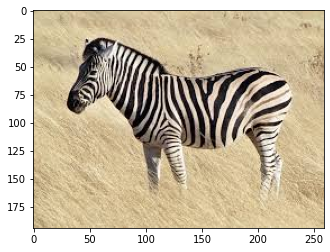

1/1 [==============================] - 0s 32ms/step
[[5.1709216e-05 5.5248724e-06 1.5191763e-06 9.9994123e-01]]
real:_122223874_gettyimages-590685251.jpg
predict:Zebra


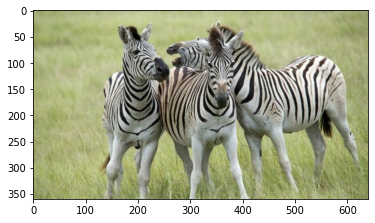

1/1 [==============================] - 0s 34ms/step
[[9.99987960e-01 1.26653759e-07 1.16438805e-05 2.83007410e-07]]
real:images (5).jpg
predict:Buffalo


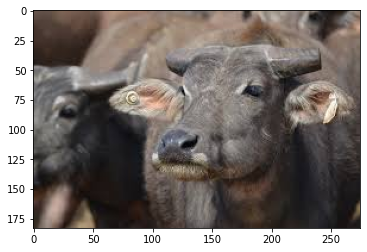

1/1 [==============================] - 0s 31ms/step
[[0.9236136  0.04915935 0.00116483 0.02606221]]
real:water-buffalo-on-a-animal-market-san-patong-province-chiang-mai-in-thailand-RHDP11.jpg
predict:Buffalo


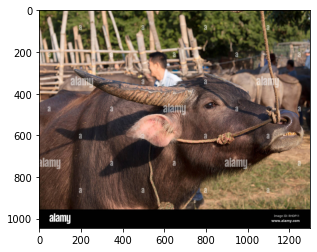

1/1 [==============================] - 0s 35ms/step
[[9.9998033e-01 1.8874963e-06 1.2427110e-05 5.2888959e-06]]
real:Water-buffalo3.jpg
predict:Buffalo


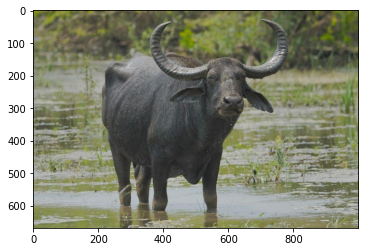

1/1 [==============================] - 0s 31ms/step
[[8.7697238e-01 8.2829694e-04 1.2187724e-01 3.2209486e-04]]
real:thai-buffalo-farming-in-the-field-free-photo.jpg
predict:Buffalo


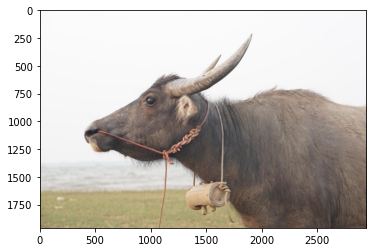

1/1 [==============================] - 0s 30ms/step
[[9.9989331e-01 9.7365883e-05 6.4769201e-06 2.8043016e-06]]
real:images (10).jpg
predict:Buffalo


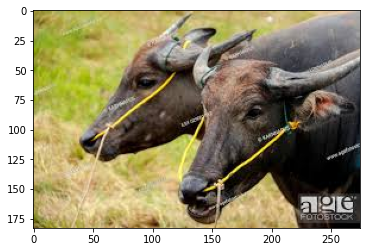

1/1 [==============================] - 0s 42ms/step
[[9.981987e-01 4.464612e-05 7.773938e-04 9.793804e-04]]
real:thai-style-water-buffalo-house-in-thai-buffalo-farm-E4JJ84.jpg
predict:Buffalo


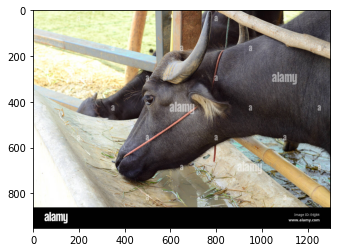

1/1 [==============================] - 0s 31ms/step
[[9.9999785e-01 1.2168630e-06 8.4483986e-07 1.3533007e-07]]
real:images.jpg
predict:Buffalo


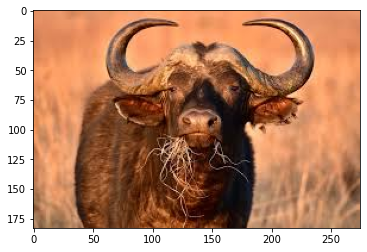

1/1 [==============================] - 0s 32ms/step
[[9.9810839e-01 1.5516776e-05 1.8709955e-03 5.1634593e-06]]
real:tied-buffalo-standing-in-field-village-donje-pune-maharashtra-india-ET0YBM.jpg
predict:Buffalo


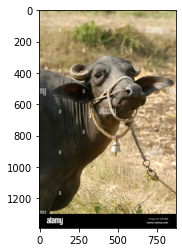

1/1 [==============================] - 0s 30ms/step
[[9.9974591e-01 6.9957699e-05 1.6439019e-04 1.9764266e-05]]
real:images (13).jpg
predict:Buffalo


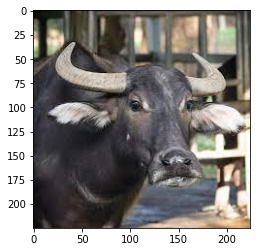

1/1 [==============================] - 0s 32ms/step
[[9.9543899e-01 9.3831477e-05 4.2774603e-03 1.8967716e-04]]
real:thai-buffalo-walks-to-eat-grass-in-a-wide-field-free-photo.jpg
predict:Buffalo


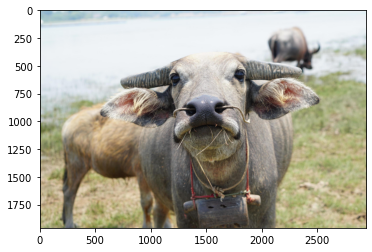

1/1 [==============================] - 0s 33ms/step
[[9.9999988e-01 2.4793165e-09 1.2593104e-07 4.9191651e-09]]
real:218978702_73555ae7d1_b.jpg
predict:Buffalo


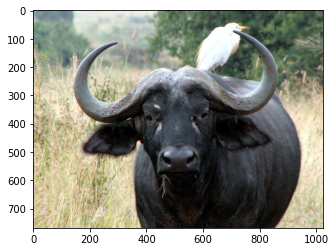

1/1 [==============================] - 0s 33ms/step
[[9.9998057e-01 2.1174378e-07 1.8950099e-05 2.3040138e-07]]
real:images (3).jpg
predict:Buffalo


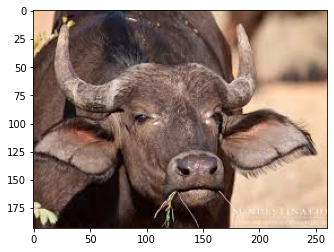

1/1 [==============================] - 0s 32ms/step
[[9.9999964e-01 8.5849656e-08 2.4340483e-07 2.7609499e-08]]
real:bufallo-gcooke-480x272.jpg
predict:Buffalo


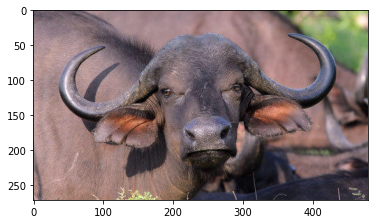

1/1 [==============================] - 0s 30ms/step
[[9.9998248e-01 8.9930809e-06 7.7657205e-06 8.6769927e-07]]
real:istockphoto-1360454063-612x612.jpg
predict:Buffalo


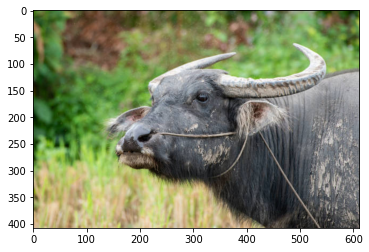

1/1 [==============================] - 0s 31ms/step
[[9.9762899e-01 1.8968699e-03 2.8418389e-04 1.9000292e-04]]
real:original_dimensions_Buffalo_-_Picture_Adriaan_Mulder.jpg
predict:Buffalo


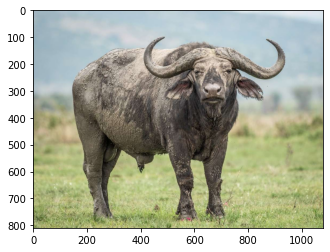

1/1 [==============================] - 0s 51ms/step
[[0.75932425 0.12455478 0.00961841 0.10650253]]
real:19590005.jpg
predict:Buffalo


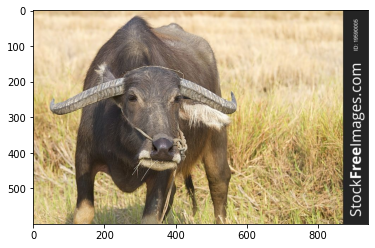

1/1 [==============================] - 0s 32ms/step
[[9.9938381e-01 2.6842608e-04 7.4806599e-06 3.4032893e-04]]
real:images (4).jpg
predict:Buffalo


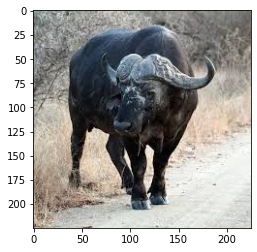

1/1 [==============================] - 0s 32ms/step
[[9.9999702e-01 2.2085753e-06 2.9448341e-07 3.8123997e-07]]
real:endangered_water_buffalo.jpg
predict:Buffalo


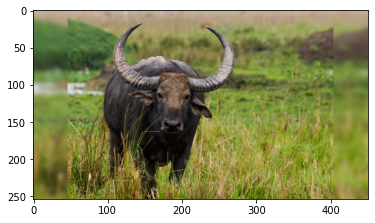

1/1 [==============================] - 0s 30ms/step
[[9.9828374e-01 2.5137256e-06 1.4783047e-03 2.3545613e-04]]
real:images (14).jpg
predict:Buffalo


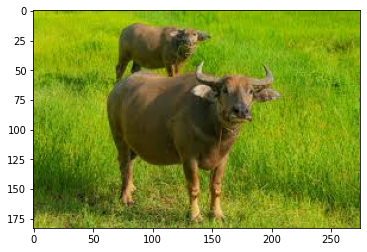

1/1 [==============================] - 0s 35ms/step
[[9.8572820e-01 1.3189720e-02 1.6993984e-04 9.1217476e-04]]
real:big-thai-buffalo-long-horns-water-thailand-140254174.jpg
predict:Buffalo


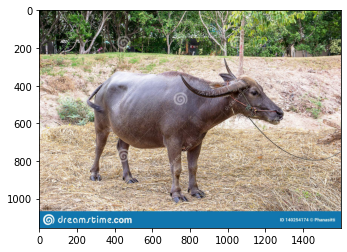

1/1 [==============================] - 0s 31ms/step
[[9.9969172e-01 9.0874804e-05 1.8024660e-04 3.7065111e-05]]
real:images (11).jpg
predict:Buffalo


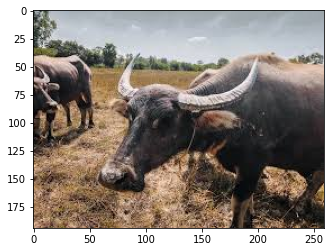

1/1 [==============================] - 0s 31ms/step
[[9.8459506e-01 1.5402169e-02 9.0682124e-07 1.9128454e-06]]
real:images (8).jpg
predict:Buffalo


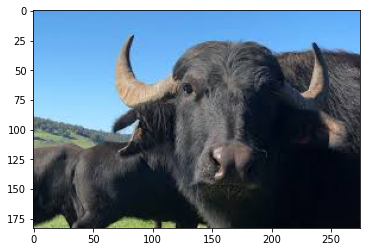

1/1 [==============================] - 0s 33ms/step
[[9.9911898e-01 1.3559291e-04 2.1744827e-05 7.2370347e-04]]
real:thai-buffalo-wooden-stall_35691-2298.jpg
predict:Buffalo


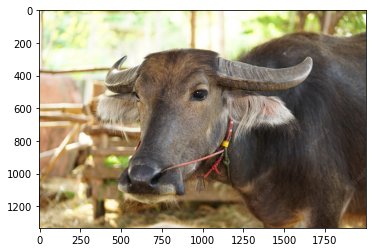

1/1 [==============================] - 0s 31ms/step
[[9.9983323e-01 6.2622726e-06 1.5754503e-04 2.9154953e-06]]
real:african-buffalo-resting-ground_181624-25601.jpg
predict:Buffalo


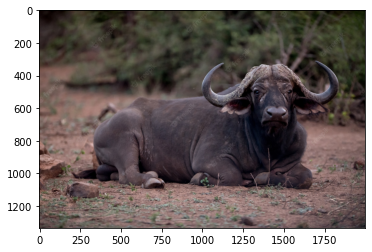

1/1 [==============================] - 0s 32ms/step
[[9.9310511e-01 1.4128719e-03 5.3762197e-03 1.0582159e-04]]
real:P03012697_pic1.jpg
predict:Buffalo


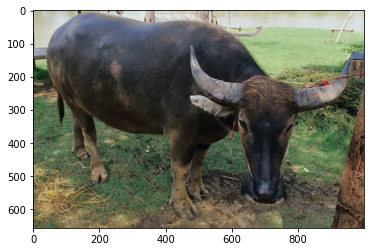

1/1 [==============================] - 0s 32ms/step
[[9.9740368e-01 3.4992766e-04 2.1431088e-03 1.0325505e-04]]
real:images (15).jpg
predict:Buffalo


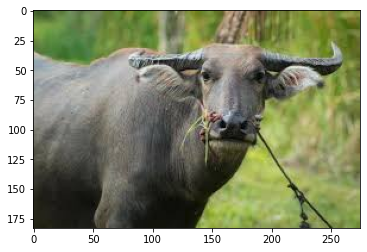

1/1 [==============================] - 0s 29ms/step
[[9.9997938e-01 9.1131881e-08 1.9773654e-05 7.8239873e-07]]
real:istockphoto-846355338-612x612.jpg
predict:Buffalo


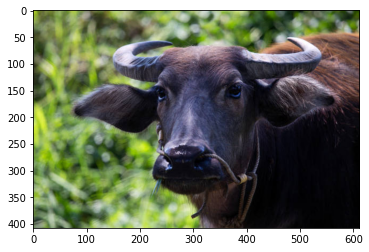

1/1 [==============================] - 0s 32ms/step
[[9.9999976e-01 3.2876834e-08 1.5040783e-07 6.4327985e-08]]
real:wild-water-buffalo_18861.jpg
predict:Buffalo


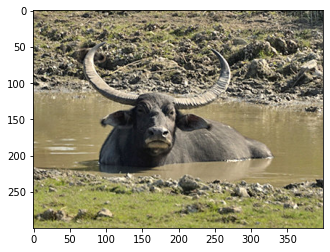

1/1 [==============================] - 0s 31ms/step
[[9.9943537e-01 5.5253220e-04 6.1047103e-06 5.9153308e-06]]
real:sanpatong-buffalo-market.jpg
predict:Buffalo


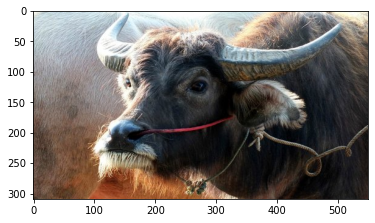

1/1 [==============================] - 0s 32ms/step
[[0.80851024 0.07792839 0.11269318 0.00086821]]
real:buffalo-gb9e07fa4e_1280.jpg
predict:Buffalo


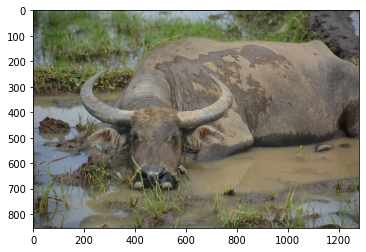

1/1 [==============================] - 0s 32ms/step
[[9.9936372e-01 1.5147215e-05 6.0825743e-04 1.2903262e-05]]
real:images (7).jpg
predict:Buffalo


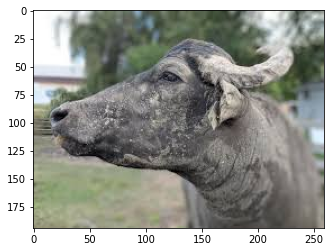

1/1 [==============================] - 0s 35ms/step
[[9.9999976e-01 1.1762300e-07 1.1470394e-07 1.1044164e-08]]
real:images (2).jpg
predict:Buffalo


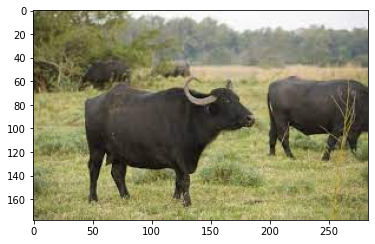

1/1 [==============================] - 0s 32ms/step
[[0.8384853  0.15857612 0.00194949 0.00098906]]
real:images (17).jpg
predict:Buffalo


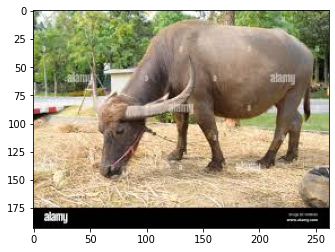

1/1 [==============================] - 0s 34ms/step
[[9.9995124e-01 2.0926600e-05 2.5591535e-05 2.2015536e-06]]
real:Indian_Water_Buffalo_Bubalus_arnee_by_Dr_Raju_Kasambe_IMG_0347_(11)_(cropped).jpg
predict:Buffalo


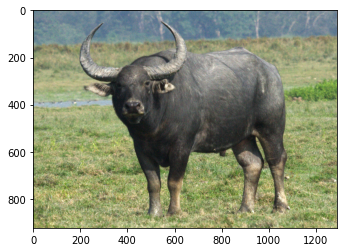

1/1 [==============================] - 0s 32ms/step
[[9.9555439e-01 2.0989713e-03 1.9744686e-03 3.7212484e-04]]
real:wild-water-buffaloes-bubalus-arnee-in-water-lucknow-uttar-pradesh-B23D78.jpg
predict:Buffalo


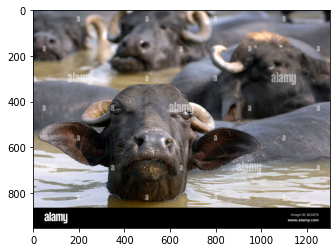

1/1 [==============================] - 0s 33ms/step
[[9.9999762e-01 1.8263128e-06 1.7763071e-08 5.9184526e-07]]
real:images (6).jpg
predict:Buffalo


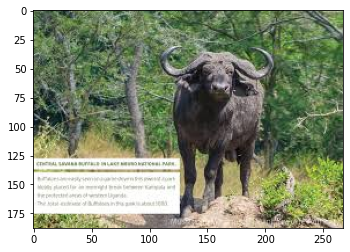

1/1 [==============================] - 0s 30ms/step
[[9.9999940e-01 5.5055614e-07 1.7244844e-09 1.2305526e-08]]
real:images (16).jpg
predict:Buffalo


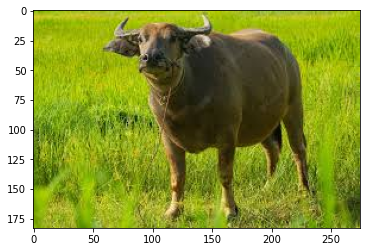

1/1 [==============================] - 0s 31ms/step
[[9.9999607e-01 3.5683880e-07 1.0192319e-06 2.6008292e-06]]
real:water-buffalo-bubalus-bubalis-in-phuket-thailand-JGN6E9.jpg
predict:Buffalo


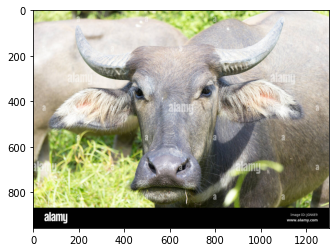

1/1 [==============================] - 0s 36ms/step
[[9.9999475e-01 6.1488021e-07 2.3210182e-06 2.3796426e-06]]
real:1000_F_117488293_DgCFVog1jgtM31YjfMyvZvwSTT3JJnzM.jpg
predict:Buffalo


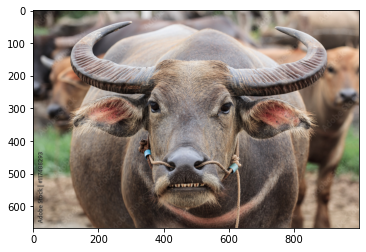

1/1 [==============================] - 0s 65ms/step
[[9.9991286e-01 6.9511196e-05 1.3260071e-05 4.4276408e-06]]
real:istockphoto-951392508-1024x1024.jpg
predict:Buffalo


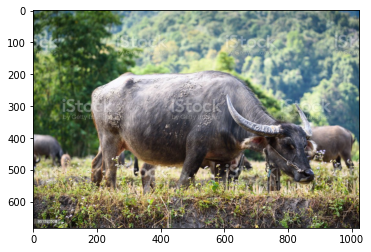

1/1 [==============================] - 0s 62ms/step
[[9.9952686e-01 2.0701830e-04 2.4992067e-04 1.6212281e-05]]
real:images (9).jpg
predict:Buffalo


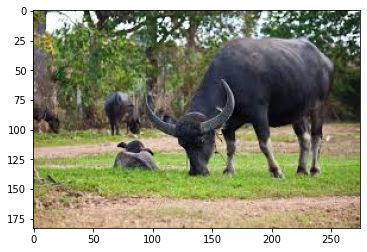

1/1 [==============================] - 0s 65ms/step
[[9.3992037e-01 4.5257628e-05 4.3001818e-04 5.9604321e-02]]
real:9e4d3e733fc343fc39fd7b00644fe06c.jpg
predict:Buffalo


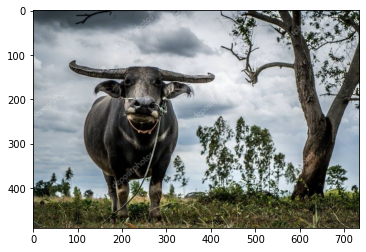

1/1 [==============================] - 0s 47ms/step
[[9.9999285e-01 4.5238503e-06 1.5422335e-06 1.0576047e-06]]
real:images (1).jpg
predict:Buffalo


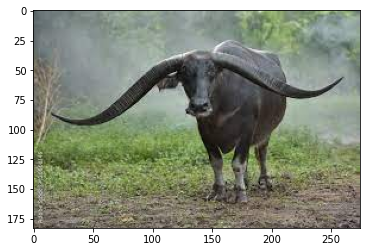

1/1 [==============================] - 0s 30ms/step
[[9.9996543e-01 2.1869594e-06 2.6432717e-05 6.0253656e-06]]
real:360_F_308892882_cSUxPcQ5FTQmx3gLO0NrdX8U6C1XXOkz.jpg
predict:Buffalo


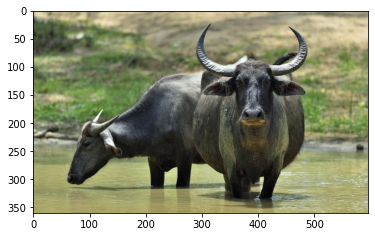

1/1 [==============================] - 0s 32ms/step
[[9.9993753e-01 8.8723009e-06 2.2031290e-05 3.1656542e-05]]
real:images (12).jpg
predict:Buffalo


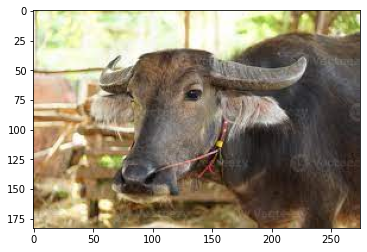

1/1 [==============================] - 0s 34ms/step
[[9.9997890e-01 4.1617490e-08 2.1095355e-05 1.8229182e-08]]
real:SpeciesPage_AfricanBuffalo02_Challenges.jpg
predict:Buffalo


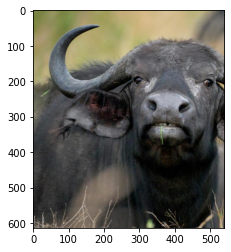

1/1 [==============================] - 0s 59ms/step
[[3.4914538e-03 4.1534822e-03 9.9214447e-01 2.1063592e-04]]
real:group-water-buffalo-thai-countryside-southern-thailand-picture-stall-215882876.jpg
predict:Rhino


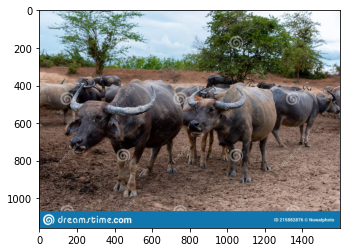

1/1 [==============================] - 0s 36ms/step
[[9.9179828e-01 8.0852187e-04 7.0576654e-03 3.3555264e-04]]
real:16085988978_1b8fc5a42b_b.jpg
predict:Buffalo


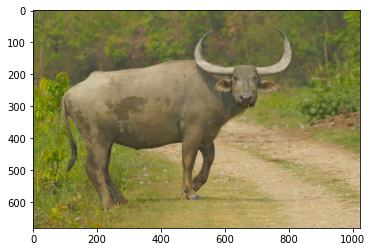

1/1 [==============================] - 0s 30ms/step
[[9.9968719e-01 2.3084962e-04 4.9842001e-05 3.2166638e-05]]
real:water-buffalo-694650.jpg
predict:Buffalo


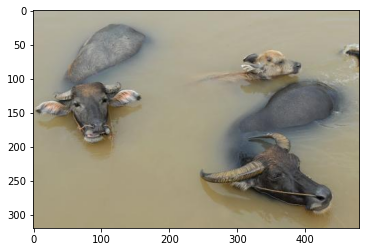

1/1 [==============================] - 0s 33ms/step
[[7.6738964e-03 9.9231780e-01 5.5707255e-07 7.7825125e-06]]
real:stock-photo-long-horn-thai-buffalo-thailand-61584793.jpg
predict:Elephant


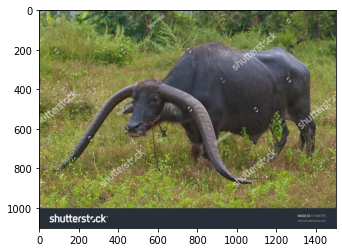

In [ ]:
testpath = '/content/test/'
testImg = [testpath+f for f in listdir(testpath) if listdir(join(testpath, f))]
rimg = []
for imagePath in (testImg):
    for item in (os.listdir(imagePath)):
        file = os.path.join(imagePath, item)
        if item.split('.')[0] != "":
           
          img = cv2.imread(file , cv2.COLOR_BGR2RGB)
          ori = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
          img = cv2.resize(img ,(width,width))
          rimg = np.array(img)
          rimg = rimg.astype('float32')
          rimg /= 255
          rimg = np.reshape(rimg ,(1,128,128,3))
          predict = transf_model.predict(rimg)
          label = ['Buffalo','Elephant','Rhino','Zebra']
          result = label[np.argmax(predict)]
          print(predict)
          print('real:'+str(item))
          print('predict:'+str(result))
          plt.imshow(ori)
          plt.show()